<div>
<img src=https://www.institutedata.com/wp-content/uploads/2019/10/iod_h_tp_primary_c.svg width="300">
</div>

# MiniProject 3 - July 2022

## Gayle Ferguson

# Can we use Natural Language Processing and Machine Learning Models to Detect ‘Fake’ vs ‘Real’ News?

The spread of misinformation online, though websites and social media platforms, is of increasing concern as many of these fake news stories, websites and videos can look very convincing.  Social media platforms need to develop increasingly sophisticated algorithms to detect misinformation, in real time, before it is shared and "goes viral". 

This project makes use of a large collection of 'fake' and 'true' "news" stories, posted May 2015 - Jan 2018, harvested and stored in two .csv files to train and evaluate machine learning algorithms to accurately distinguish between 'fake' and 'true' headlines and body.

The data was downloaded from Kaggle : https://www.kaggle.com/datasets/clmentbisaillon/fake-and-real-news-dataset and is published in the following academic journal articles:

Ahmed H, Traore I, Saad S. (2018) “Detecting opinion spams and fake news using text classification”, Journal of Security and Privacy, Volume 1(1).

Ahmed H, Traore I, Saad S. (2017) “Detection of Online Fake News Using N-Gram Analysis and Machine Learning Techniques. In: Traore I., Woungang I., Awad A. (eds) Intelligent, Secure, and Dependable Systems in Distributed and Cloud Environments. ISDDC 2017. Lecture Notes in Computer Science, Vol 10618. Springer, Cham (pp. 127-138).

## Aims and Objectives

1. To clean and prepare the data for analysis using regex and other tools to remove erroneous entries, punctuation,  and stopwords, and to convert to tokens from text to lemas.
2. To generate new features from existing data, for example, word counts, punctuation counts etc, and to convert 'objects' to numerical data ('vectorization') that can be input to machine learning models.
3. To train and evaluate a selection of supervised learning models in order to correctly predict the classification of new, unseen news stories.

In [208]:
## Import Libraries
import pandas as pd
!jupyter nbextension enable --py widgetsnbextension
from tqdm.notebook import tqdm, trange
import time    # to be used in loop iterations
from textwrap import wrap

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from os import path
from PIL import Image

import regex as re
import string
import spacy
from collections import Counter
from datetime import datetime
from sklearn.decomposition import PCA

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from mlxtend.classifier import StackingClassifier
from mlxtend.plotting import plot_learning_curves

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import learning_curve
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

import warnings
warnings.filterwarnings('ignore')

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [11]:
fake = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/Fake.csv', header=0, sep=',')
true = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/True.csv', header=0, sep=',')

## DATA CLEANING & EDA 

In [13]:
fake.shape

(23481, 4)

In [14]:
# Initialise a new column for the 'target' labels for each dataframe
fake['target'] = 0
true['target'] = 1

In [15]:
# Check dataframe
fake.head()
#true.head()

,title,text,subject,date,target
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",0
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",0
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",0
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",0
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",0


In [16]:
# Checking subject categories in 'fake' vs 'true' datasets
print(fake.value_counts('subject'))

subject
News               9050
politics           6841
left-news          4459
Government News    1570
US_News             783
Middle-east         778
dtype: int64


In [17]:
# Checking subject categories in 'fake' vs 'true' datasets
print(true.value_counts('subject'))

subject
politicsNews    11272
worldnews       10145
dtype: int64


In [18]:
# Replaced 'politicsNews' in 'True' dataset to match the labelling in the 'Fake' dataset
true['subject'] = true['subject'].str.replace('politicsNews', 'politics')

In [19]:
# Concat the 'true' and 'fake' dataframes to make a single dataframe called 'news'. 

news = pd.concat([fake, true], axis=0)
print(news.shape)
news

(44898, 5)


,title,text,subject,date,target
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",0
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",0
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",0
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",0
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",0
...,...,...,...,...,...
21412,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",1
21413,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",1
21414,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",1
21415,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",1


subject
politics           18113
worldnews          10145
News                9050
left-news           4459
Government News     1570
US_News              783
Middle-east          778
dtype: int64


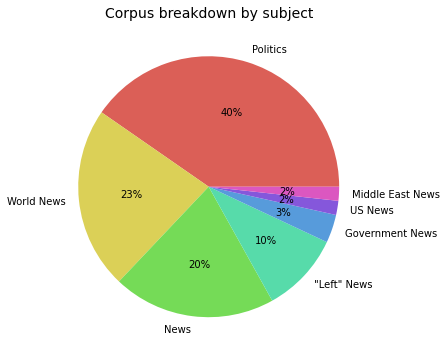

In [20]:
# Visualise subject categories overall
print(news.value_counts('subject'))

fig, ax = plt.subplots(figsize=(10,6))
# define data
plotdata = news.value_counts('subject')
labels = ['Politics', 'World News', 'News', '"Left" News', 'Government News', 'US News', 'Middle East News']

# define Seaborn color palette to use
colors = sns.color_palette("hls", 7)

# create pie chart
ax = plt.pie(plotdata, labels = labels, colors = colors, autopct='%.0f%%')
plt.title('Corpus breakdown by subject', fontsize=14)
fig.savefig("Corpus_by_subject.jpg")
plt.show()

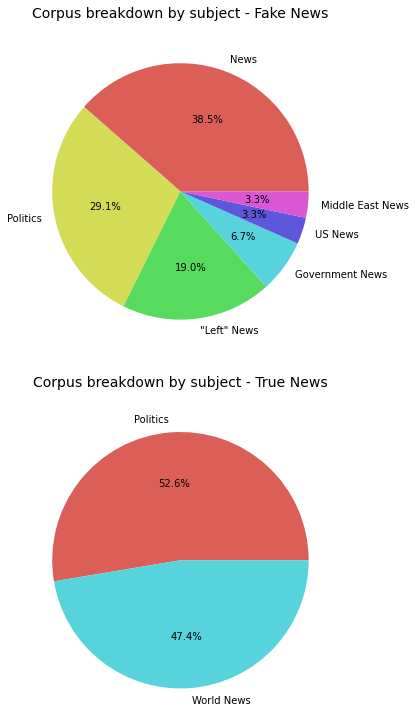

In [21]:
# Visualise corpus breakdown by subject for True vs Fake datasets
   # I can't figure out how to make the colurs by subject the same for each plot 

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(10,10))
colors1 = sns.color_palette("hls", 6)
colors2 = sns.color_palette("hls", 2)
plotdata1 = fake.value_counts('subject')
plotdata2 = true.value_counts('subject')

ax1.pie(plotdata1, labels=['News', 'Politics', '"Left" News', 'Government News', 'US News', 'Middle East News'], colors = colors1, radius = 1.2,autopct = '%1.1f%%')
ax2.pie(plotdata2, labels=['Politics', 'World News'], colors = colors2, radius = 1.2,autopct = '%1.1f%%')
ax1.set_title('Corpus breakdown by subject - Fake News', fontsize=14, pad=40)
ax2.set_title('Corpus breakdown by subject - True News', fontsize=14, pad=40)

fig.savefig("Corpus_by_subject_FakevsTrue.jpg")
plt.tight_layout(h_pad=4)
plt.show()

The pie graphs above show that the documents within the 'fake' dataset have been categorised differently to those within the 'true' dataset: it is unlikely that the 'true' documents don't cover 'government news', 'US news' etc, rather that everything has simply been tagged as either 'politics' or 'world news'.  These 'subject' categories are therefore not useful as a predictive feature, and would not be a useful predictive feature in any case since these are most likely 'human-derived' and subjective. 

In [22]:
# Checking for null values - there are none
news.isnull().sum()

title      0
text       0
subject    0
date       0
target     0
dtype: int64

In [23]:
# Checking data types - all 'objects' (strings) except for the 'target' column, which is integers
news.dtypes

title      object
text       object
subject    object
date       object
target      int64
dtype: object

### The Subject Column 

I did not end up using the 'subject' feature in my models, but did intially process this data by converting it to dummy encodings. 

In [24]:
%%time
# Convert 'subject' catagories to dummy variables
  # 'subject_Government News' has been dropped to avoid colinearity

news = pd.get_dummies(news, prefix=['subject'], prefix_sep='_', 
                    columns=['subject'], sparse=False, drop_first=True)

CPU times: user 13.3 ms, sys: 3.58 ms, total: 16.9 ms
Wall time: 18.7 ms


### The Date Column 

The date feature was also not used in the modelling, but was cleaned up and converted to 'datetime' in order to generate a plot of news articles by date. 

The dates are present as strings, with a variety of formats, and need to be converted to numerical entries with a consistent format. 

In [25]:
# Remove capitalisation from the 'date' column
news['date'] = news['date'].str.lower()

# Insert '/' after month
news['date'] = news['date'].str.replace('\s', '/')

# Remove the 'comma'
news['date'] = news['date'].str.replace(',', '')

In [26]:
# Convert date strings to integers
news['date'] = news['date'].str.replace('jan\w*', '01')
news['date'] = news['date'].str.replace('feb\w*', '02')
news['date'] = news['date'].str.replace('mar\w*', '03')
news['date'] = news['date'].str.replace('apr\w*', '04')
news['date'] = news['date'].str.replace('may\w*', '05')
news['date'] = news['date'].str.replace('jun\w*', '06')
news['date'] = news['date'].str.replace('jul\w*', '07')
news['date'] = news['date'].str.replace('aug\w*', '08')
news['date'] = news['date'].str.replace('sep\w*', '09')
news['date'] = news['date'].str.replace('oct\w*', '10')
news['date'] = news['date'].str.replace('nov\w*', '11')
news['date'] = news['date'].str.replace('dec\w*', '12')

# Remove any new lines or spaces from the 'date' column
news['date'] = news['date'].str.replace('\n', '')
news['date'] = news['date'].str.replace('\s', '')

In [27]:
# There are some additional punctuation marks (hyphens) in the date column that need to be removed

date = news['date'].tolist() 
date = ' '.join(date)
re.findall('-', date)

['-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-',
 '-']

In [28]:
# Remove the 'hyphens'
news['date'] = news['date'].str.replace('-', '')

In [29]:
# There are some URLs in the date column that need to be removed

re.findall('http\S+', date)

['https://100percentfedup.com/served-roy-moore-vietnamletter-veteran-sets-record-straight-honorable-12-respectable-patriotic-commander-soldier/',
 'https://100percentfedup.com/video-hillary-asked-about-trump-i-just-want-to-eat-some-pie/',
 'https://100percentfedup.com/12-yr-old-black-conservative-whose-video-to-obama-went-viral-do-you-really-love-america-receives-death-threats-from-left/',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg',
 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg']

In [30]:
# Remove the URLs (I couldn't get this to work as a regex on a dataframe column)

URL1 = 'https://100percentfedup.com/served-roy-moore-vietnamletter-veteran-sets-record-straight-honorable-decent-respectable-patriotic-commander-soldier/'
URL2 = 'https://100percentfedup.com/video-hillary-asked-about-trump-i-just-want-to-eat-some-pie/'
URL3 = 'https://100percentfedup.com/12-yr-old-black-conservative-whose-video-to-obama-went-viral-do-you-really-love-america-receives-death-threats-from-left/'
URL4 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg'
URL5 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg'
URL6 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg'
URL7 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg'
URL8 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/hillarystreetart.jpg'
URL9 = 'https://fedup.wpengine.com/wp-content/uploads/2015/04/entitled.jpg'
URL10 = 'https://100percentfedup.com/servedroymoorevietnamletterveteransetsrecordstraighthonorable12respectablepatrioticcommandersoldier'
URL11 = 'https://100percentfedup.com/videohillaryaskedabouttrumpijustwanttoeatsomepie'
URL12 = 'https://100percentfedup.com/12yroldblackconservativewhosevideotoobamawentviraldoyoureallyloveamericareceivesdeaththreatsfromleft'
URL13 = 'https://fedup.wpengine.com/wpcontent/uploads/2015/04/hillarystreetart.jpg'
URL14 = 'https://fedup.wpengine.com/wpcontent/uploads/2015/04/entitled.jpg'
URL15 = 'msnbc/host/rudely/assumes/steel/worker/would/never/let/his/son/follow/in/his/footsteps…he/couldn’t/be/more/wrong/[video]'

news['date'] = news['date'].str.replace(URL1, '')
news['date'] = news['date'].str.replace(URL2, '')
news['date'] = news['date'].str.replace(URL3, '')
news['date'] = news['date'].str.replace(URL4, '')
news['date'] = news['date'].str.replace(URL5, '')
news['date'] = news['date'].str.replace(URL6, '')
news['date'] = news['date'].str.replace(URL7, '')
news['date'] = news['date'].str.replace(URL8, '')
news['date'] = news['date'].str.replace(URL9, '')
news['date'] = news['date'].str.replace(URL10, '')
news['date'] = news['date'].str.replace(URL11, '')
news['date'] = news['date'].str.replace(URL12, '')
news['date'] = news['date'].str.replace(URL13, '')
news['date'] = news['date'].str.replace(URL14, '')
news['date'] = news['date'].str.replace(URL15, '')
news['date'] = news['date'].str.replace('msnbc.+', '')

In [31]:
# Remove the final forward slash (/)
news['date'] = news['date'].str.replace('/$', '')
news.sample(3)

,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews
23039,SUNDAY SCREENING: Counter Intelligence – ‘The ...,21st Century Wire says Our weekly documentary ...,01/22/2017,0,1,0,0,0,0,0
3050,Donald Trump Proves He Knows NOTHING About Am...,During Donald Trump s most recent press confer...,01/11/2017,0,0,1,0,0,0,0
585,Obamacare mandate in U.S. Senate tax plan not ...,WASHINGTON (Reuters) - U.S. Treasury Secretary...,11/19/2017,1,0,0,0,0,1,0


In [32]:
# Convert to datetime
news['date'] = pd.to_datetime(news['date'])

In [33]:
# Check the data
news.sort_values('date')

,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews
15885,FLASHBACK: KING OBAMA COMMUTES SENTENCES OF 22...,Just making room for Hillary President Obama t...,2015-03-31,0,0,0,0,0,1,0
15890,HILLARY RODHAM NIXON: A CANDIDATE WITH MORE BA...,The irony here isn t lost on us. Hillary is be...,2015-03-31,0,0,0,0,0,1,0
15889,BENGHAZI PANEL CALLS HILLARY TO TESTIFY UNDER ...,Does anyone really think Hillary Clinton will ...,2015-03-31,0,0,0,0,0,1,0
15888,OH NO! GUESS WHO FUNDED THE SHRINE TO TED KENNEDY,Nothing like political cronyism to make your s...,2015-03-31,0,0,0,0,0,1,0
15887,WATCH DIRTY HARRY REID ON HIS LIE ABOUT ROMNEY...,"In case you missed it Sen. Harry Reid (R-NV), ...",2015-03-31,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
17432,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,0,0
17433,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,0,0
18933,Homepage,[vc_row][vc_column width= 1/1 ][td_block_trend...,NaT,0,0,0,0,1,0,0
21869,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,1,0,0


In [34]:
# There are some NaT entries in the 'date' column
news[news.date.isnull()]

,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews
9358,https://100percentfedup.com/served-roy-moore-v...,https://100percentfedup.com/served-roy-moore-v...,NaT,0,0,0,0,0,1,0
15507,https://100percentfedup.com/video-hillary-aske...,https://100percentfedup.com/video-hillary-aske...,NaT,0,0,0,0,0,1,0
15508,https://100percentfedup.com/12-yr-old-black-co...,https://100percentfedup.com/12-yr-old-black-co...,NaT,0,0,0,0,0,1,0
15839,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,1,0
15840,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,1,0
17432,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,0,0
17433,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,0,0,0
18933,Homepage,[vc_row][vc_column width= 1/1 ][td_block_trend...,NaT,0,0,0,0,1,0,0
21869,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,1,0,0
21870,https://fedup.wpengine.com/wp-content/uploads/...,https://fedup.wpengine.com/wp-content/uploads/...,NaT,0,0,0,0,1,0,0


In [35]:
# Remove all rows with NaT values, which will also remove entries that have URLs instead of text
news = news.dropna()

In [36]:
# Recheck date ranges
news.sort_values('date')

,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews
15885,FLASHBACK: KING OBAMA COMMUTES SENTENCES OF 22...,Just making room for Hillary President Obama t...,2015-03-31,0,0,0,0,0,1,0
15890,HILLARY RODHAM NIXON: A CANDIDATE WITH MORE BA...,The irony here isn t lost on us. Hillary is be...,2015-03-31,0,0,0,0,0,1,0
15889,BENGHAZI PANEL CALLS HILLARY TO TESTIFY UNDER ...,Does anyone really think Hillary Clinton will ...,2015-03-31,0,0,0,0,0,1,0
15888,OH NO! GUESS WHO FUNDED THE SHRINE TO TED KENNEDY,Nothing like political cronyism to make your s...,2015-03-31,0,0,0,0,0,1,0
15887,WATCH DIRTY HARRY REID ON HIS LIE ABOUT ROMNEY...,"In case you missed it Sen. Harry Reid (R-NV), ...",2015-03-31,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
9053,JUST IN: BADASS GENERAL JOHN KELLY Shoved Chin...,Just one more reminder of why President Trump ...,2018-02-18,0,0,0,0,0,1,0
9056,GOTCHA! A Stammering John Podesta Stunned by a...,John Podesta is Hillary Clinton s former campa...,2018-02-18,0,0,0,0,0,1,0
9052,WATCH: SNOWFLAKES ASKED Communist Party Platfo...,Ami Horowitz is fantastic! Check out this man ...,2018-02-19,0,0,0,0,0,1,0
9051,MSNBC ANCHOR Flabbergasted at What Texas Teach...,If we protect every other government building ...,2018-02-19,0,0,0,0,0,1,0


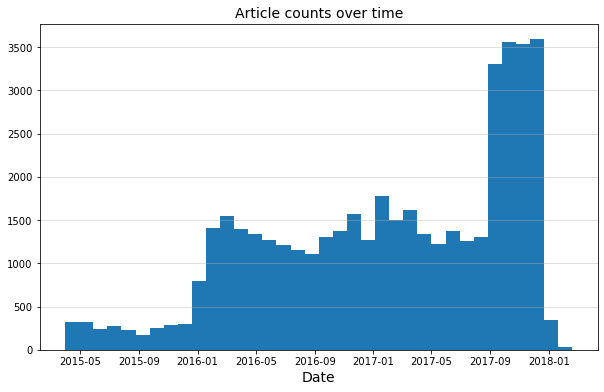

In [37]:
# Plot document counts over time
sns.set_style()
fig, ax = plt.subplots(figsize = (10,6))
plt.hist(news.date, bins=36, histtype='stepfilled')
plt.xlabel("Date", fontsize=14)
#plt.ylabel("Counts", fontsize=14)  #It won't let me label the y-axis
plt.title("Article counts over time", fontsize=14)
plt.grid(visible=True, which='major', axis='y', alpha=0.5)
fig.savefig("title_counts_by_date.jpg")
plt.show()

### The 'Title' Column 

In [38]:
%%time
# Remove stopwords, punctuation, stem and lemmatize

nlp = spacy.load("en_core_web_md")       

# Convert each row into spacy document and return the lemma of the tokens in 
# the document if it is not a stop word. Finally, join the lemmas into a string
news['title_lema'] = news['title'].apply(lambda text: 
                                          " ".join(token.lemma_ for token in nlp(text) 
                                                   if not token.is_stop))

CPU times: user 3min 21s, sys: 1.46 s, total: 3min 23s
Wall time: 3min 23s


In [39]:
%%time
# The function above is not removing punctuation, so I need to do this again
news['title_lema'] = news['title_lema'].str.replace(r'[^\w\s]+', '')

CPU times: user 117 ms, sys: 23.2 ms, total: 140 ms
Wall time: 161 ms


In [40]:
%%time
# Remove capitalisation
news['title_lema'] = news['title_lema'].str.lower()

CPU times: user 9.91 ms, sys: 899 µs, total: 10.8 ms
Wall time: 10.1 ms


### The Text Column 

In [41]:
%%time
# Remove stopwords, punctuation, stem and lemmatize
# Convert each row into spacy document and return the lemma of the tokens in 
# the document if it is not a stop word. Finally, join the lemmas into a string
news['text_lema'] = news['text'].apply(lambda t: 
                                          " ".join(token.lemma_ for token in nlp(t) 
                                                   if not token.is_stop))

CPU times: user 48min 28s, sys: 36.3 s, total: 49min 4s
Wall time: 49min 33s


In [42]:
%%time
# The function above is not removing punctuation, so I need to do this again
news['text_lema'] = news['text_lema'].str.replace(r'[^\w\s]+', '')

CPU times: user 2.01 s, sys: 62.1 ms, total: 2.07 s
Wall time: 2.12 s


In [43]:
# Export the dataframe as a csv file

news.to_csv(r'/Users/gaylecferguson/Data/news.csv')

#### Plot a 'wordcloud' for the 'true' entries vs the 'fake' entries 

In [44]:
from wordcloud import WordCloud, STOPWORDS

In [45]:
# Reimport the data from csv
newsDF = pd.read_csv (r'/Users/gaylecferguson/Data/news.csv', header=0, sep=',')
newsDF.sample(3)

,Unnamed: 0,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews,title_lema,text_lema
17314,17319,(VIDEO) KEY CLINTON STATE DEPT EMPLOYEE BLOCKE...,(VIDEO ABOVE)STATE DEPARTMENT SPOKESPERSON HAR...,2015-05-21,0,0,0,0,0,0,0,video key clinton state dept employee blocke...,video ABOVESTATE DEPARTMENT SPOKESPERSON HARF...
861,861,Racist Chicago Cop Who Beat A Handcuffed Blac...,Chicago Police Sergeant George Granias abuse ...,2017-07-13,0,0,1,0,0,0,0,racist chicago cop beat handcuffed black wom...,Chicago Police Sergeant George Granias abuse...
31942,8471,California lawmaker to float zero emissions ve...,SAN FRANCISCO (Reuters) - A California lawmake...,2016-08-12,1,0,0,0,0,1,0,california lawmaker float zero emission vehicl...,SAN FRANCISCO Reuters California lawmaker w...


In [46]:
# Prepare stemmed, lemmatized text for analysis and plotting
true = newsDF.loc[newsDF['target'] == 1]
true = true[['text_lema']]
true = true.sample(500)
true.shape

(500, 1)

In [47]:
fake = newsDF.loc[newsDF['target'] == 0]
fake = fake[['text_lema']]
fake = fake.sample(500)
fake.shape

(500, 1)

In [48]:
# Export the dataframes as new csv files then save as txt files outside of Jupyter notebook
fake.to_csv(r'/Users/gaylecferguson/Data/fake.csv')
true.to_csv(r'/Users/gaylecferguson/Data/true.csv')

In [49]:
fake_text = '/Users/gaylecferguson/Data/MiniProject3/fake.txt'
with open(fake_text, 'r') as f:
    faketext = f.read()
    
true_text = '/Users/gaylecferguson/Data/MiniProject3/true.txt'
with open(true_text, 'r') as t:
    truetext = t.read()    

In [50]:
# Perform some tidying
faketext = re.sub('\t', ' ', faketext)
faketext = re.sub('\n', ' ', faketext)
faketext = re.sub('(?<=\s+)[s](?=\s+)', '', faketext)
faketext = re.sub('(?<=\s+)[t](?=\s+)', '', faketext)

In [51]:
truetext = re.sub('\t', ' ', truetext)
truetext = re.sub('\n', ' ', truetext)
truetext = re.sub('(?<=\s+)[s](?=\s+)', '', truetext)
truetext = re.sub('(?<=\s+)[t](?=\s+)', '', truetext)

In [52]:
# load spaCy and the English model

nlp = spacy.load("en_core_web_md")

# Process the text for WordCloud plots
doc = nlp(faketext)
doc2 = nlp(truetext)

In [53]:
# Tokenization 
for i, t in enumerate(doc):
    print('%2d| %r' % (i+1, t.text))
    if t.text == '.':
        break
        
for j, u in enumerate(doc2):
    print('%2d| %r' % (j+1, u.text))
    if u.text == '.':
        break        

 1| ' '
 2| 'text_lema'
 3| '22474'
 4| '21st'
 5| 'Century'
 6| 'Wire'
 7| 'say'
 8| 'weekly'
 9| 'documentary'
10| 'film'
11| 'curate'
12| 'editorial'
13| 'team'
14| '21wireaside'
15| 'collapse'
16| 'WTC'
17| 'Building'
18| '7'
19| ' '
20| 'major'
21| 'achille'
22| 'heel'
23| 'official'
24| '911'
25| 'version'
26| 'event'
27| 'tale'
28| 'passenger'
29| 'airliner'
30| 'hit'
31| 'Pentagon'
32| ' '
33| 'follow'
34| 'independent'
35| 'investigative'
36| 'documentary'
37| 'offer'
38| 'key'
39| 'insight'
40| 'incident'
41| ' '
42| 'depend'
43| 'believe'
44| 'finding'
45| 'credible'
46| '   '
47| 'prove'
48| 'doubt'
49| 'Boeing'
50| 'passenger'
51| 'airliner'
52| 'strike'
53| 'Pentagon'
54| 'September'
55| '11'
56| ' '
57| '2001to'
58| 'date'
59| ' '
60| 'remain'
61| 'compelling'
62| 'presentation'
63| 'illustrate'
64| 'happen'
65| ' '
66| 'precisely'
67| '   '
68| 'happen'
69| '911'
70| ' '
71| 'watch'
72| ' '
73| 'SUNDAY'
74| 'screenings'
75| '10016'
76| 'President'
77| 'Trump'
78| 'Lady'

In [54]:
## spaCy
print('i | with stop words without')
print('--| --------------- ------------')

# for all the tokens
for i, t in enumerate(doc):
    print('%2d| %-15r %r' % (i+1, t.text, ('' if t.is_stop else t.text)))

    # break after the first sentence
    if t.text == '.':
        break
        
print('j | with stop words without')
print('--| --------------- ------------')

# for all the tokens
for j, u in enumerate(doc2):
    print('%2d| %-15r %r' % (j+1, u.text, ('' if u.is_stop else u.text)))

    # break after the first sentence
    if u.text == '.':
        break        

i | with stop words without
--| --------------- ------------
 1| ' '             ' '
 2| 'text_lema'     'text_lema'
 3| '22474'         '22474'
 4| '21st'          '21st'
 5| 'Century'       'Century'
 6| 'Wire'          'Wire'
 7| 'say'           ''
 8| 'weekly'        'weekly'
 9| 'documentary'   'documentary'
10| 'film'          'film'
11| 'curate'        'curate'
12| 'editorial'     'editorial'
13| 'team'          'team'
14| '21wireaside'   '21wireaside'
15| 'collapse'      'collapse'
16| 'WTC'           'WTC'
17| 'Building'      'Building'
18| '7'             '7'
19| ' '             ' '
20| 'major'         'major'
21| 'achille'       'achille'
22| 'heel'          'heel'
23| 'official'      'official'
24| '911'           '911'
25| 'version'       'version'
26| 'event'         'event'
27| 'tale'          'tale'
28| 'passenger'     'passenger'
29| 'airliner'      'airliner'
30| 'hit'           'hit'
31| 'Pentagon'      'Pentagon'
32| ' '             ' '
33| 'follow'        'follow'


In [55]:
# create a bar chart of the frequency of the words in the text
def plot_words(tokens, top = 30):
    tokens_counter = Counter(tokens)
    tok = [t for (t, _) in tokens_counter.most_common()]
    val = [v for (_, v) in tokens_counter.most_common()]

    plt.figure(figsize = (16, 6))
    plt.bar(tok[:top], val[:top])
    plt.title('Number of terms: %d' % len(tokens_counter))
    plt.xticks(rotation = 90)

    plt.show()

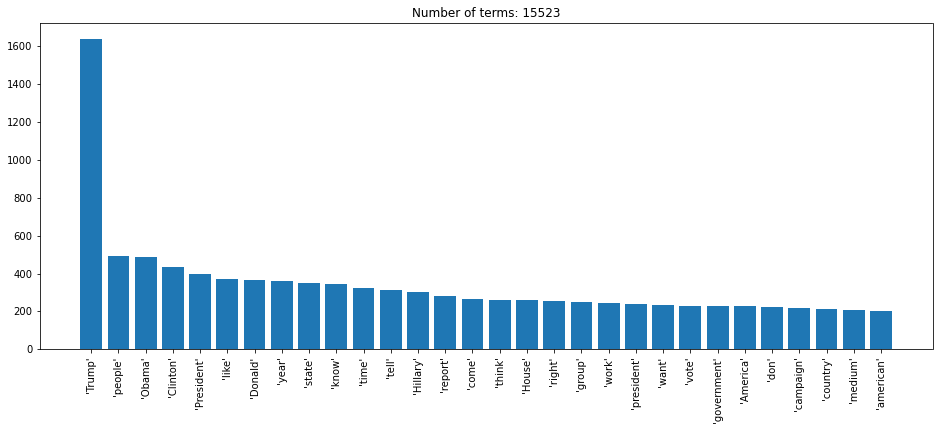

In [56]:
# Fake News Words - 'Trump' is by far the most common word!  This is also true for the 'True News Words'
plot_words(['%r' % t.text for t in doc if not (t.is_stop | t.is_punct | t.is_space)])

In [57]:
## Lemmatization
print('i | Token        Lemma')
print('--| ------------ ------------')
for i, t in enumerate(doc):
    print('%2d| %-12r %r' % (i+1, t.text, t.lemma_))
    if t.text == '.':
        break

i | Token        Lemma
--| ------------ ------------
 1| ' '          ' '
 2| 'text_lema'  'text_lema'
 3| '22474'      '22474'
 4| '21st'       '21st'
 5| 'Century'    'Century'
 6| 'Wire'       'Wire'
 7| 'say'        'say'
 8| 'weekly'     'weekly'
 9| 'documentary' 'documentary'
10| 'film'       'film'
11| 'curate'     'curate'
12| 'editorial'  'editorial'
13| 'team'       'team'
14| '21wireaside' '21wireaside'
15| 'collapse'   'collapse'
16| 'WTC'        'WTC'
17| 'Building'   'Building'
18| '7'          '7'
19| ' '          ' '
20| 'major'      'major'
21| 'achille'    'achille'
22| 'heel'       'heel'
23| 'official'   'official'
24| '911'        '911'
25| 'version'    'version'
26| 'event'      'event'
27| 'tale'       'tale'
28| 'passenger'  'passenger'
29| 'airliner'   'airliner'
30| 'hit'        'hit'
31| 'Pentagon'   'Pentagon'
32| ' '          ' '
33| 'follow'     'follow'
34| 'independent' 'independent'
35| 'investigative' 'investigative'
36| 'documentary' 'documentary'
37

There are 38850618 words in the combination of all documents.


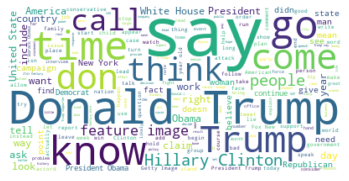

In [58]:
# Python program to generate WordCloud
 # from https://www.datacamp.com/tutorial/wordcloud-python
 
# importing all necessary modules
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

newsDF = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/news.csv', header=0, sep=',')
fake = newsDF.loc[newsDF['target'] == 0]
 
# Prepare the data:
text = " ".join(document for document in fake.text_lema)
print ("There are {} words in the combination of all documents.".format(len(text)))

# Create stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["s", "t"])

# Create and generate a word cloud image:
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)

# Display the generated image:
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

# Save the image in the img folder:
wordcloud.to_file("/Users/gaylecferguson/Data/MiniProject3/fake_wordcloud.png")

There are 34881474 words in the combination of all documents.


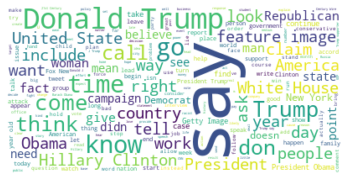

In [59]:
newsDF = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/news.csv', header=0, sep=',')
true = newsDF.loc[newsDF['target'] == 1]
 
# Prepare the data:
text2 = " ".join(document for document in true.text_lema)
print ("There are {} words in the combination of all documents.".format(len(text2)))

# Create stopword list:
stopwords2 = set(STOPWORDS)
stopwords2.update(["s", "t"])

# Create and generate a word cloud image:
wordcloud2 = WordCloud(stopwords=stopwords2, background_color="white").generate(text)

# Display the generated image:
plt.figure()
plt.imshow(wordcloud2, interpolation="bilinear")
plt.axis("off")
plt.show()

# Save the image in the img folder:
wordcloud.to_file("/Users/gaylecferguson/Data/MiniProject3/true_wordcloud.png")

## FEATURE ENGINEERING:

### Text / NLP based features  

The following features were generated from both the 'title_lema' and the 'text_lema' columns in the dataframe

In [60]:
%%time
# Word count
newsDF['word_count'] = [len(x.split()) for x in newsDF['text'].tolist()]
# Character count
newsDF['character_count'] = [len(x) for x in newsDF['text'].tolist()]
# Average word length ("word density")
newsDF['mean_word_length'] = newsDF['character_count'] / (newsDF['word_count'] + 1)  # why +1 ? To avoid division by 0?
# Punctuation Count
newsDF['punctuation_count'] = [len(x.split()) for x in newsDF['text'].tolist()]
# Number of words in 'Title Case'
newsDF['title_word_count'] = newsDF['text'].apply(lambda x: len([w for w in x.split() if w.istitle()]))
# Number of words in Uppercase
newsDF['uppercase_word_count'] = newsDF['text'].apply(lambda x: len([w for w in x.split() if w.isupper()]))
# Check the results
newsDF.sample(3)

CPU times: user 4.92 s, sys: 63.7 ms, total: 4.99 s
Wall time: 5 s


,Unnamed: 0,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_worldnews,title_lema,text_lema,word_count,character_count,mean_word_length,punctuation_count,title_word_count,uppercase_word_count
33768,10297,"Cuba changing, but only slowly, since Obama's ...",HAVANA (Reuters) - Saul Berenthal has waited f...,2016-03-17,1,0,0,0,0,1,0,cuba change slowly obama policy shift,HAVANA Reuters Saul Berenthal wait decade c...,1037,6491,6.253372,1037,138,10
2121,2121,Watch Trump Flat-Out Admit Trumpcare Will Rui...,The Republican bill meant to dismantle the Aff...,2017-03-16,0,0,1,0,0,0,0,watch trump flat admit trumpcare ruin life ...,republican bill mean dismantle Affordable Care...,352,2126,6.022663,352,38,3
38287,14816,"German parties want lobbyist registry, may man...",BERLIN (Reuters) - German parties exploring a ...,2017-11-14,1,0,0,0,0,0,1,german party want lobbyist registry mandate h...,BERLIN Reuters german party explore coaliti...,448,2841,6.327394,448,45,3


### Tagging 'Part of Speech' (POS) 

In [61]:
# Installed a status bar widget to use on for loops
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [62]:
## load spaCy
nlp = spacy.load("en_core_web_md")

In [63]:
# Initialise some columns for feature counts
newsDF['adj_count_title'] = 0
newsDF['adv_count_title'] = 0
newsDF['noun_count_title'] = 0
newsDF['num_count_title'] = 0
newsDF['pron_count_title'] = 0
newsDF['propn_count_title'] = 0
newsDF['verb_count_title'] = 0

newsDF['adj_count_text'] = 0
newsDF['adv_count_text'] = 0
newsDF['noun_count_text'] = 0
newsDF['num_count_text'] = 0
newsDF['pron_count_text'] = 0
newsDF['propn_count_text'] = 0
newsDF['verb_count_text'] = 0

In [64]:
%%time
# Generating feature counts for different parts of speech - on the 'title' data
# for each text in 'title' column

for i in tqdm(range(newsDF.shape[0])):
    pass
    # convert into a spaCy document
    doc = nlp(newsDF.iloc[i]['title'])
    # initialise feature counters
    c = Counter([t.pos_ for t in doc])

    newsDF.at[i, 'adj_count_title'] = c['ADJ']
    newsDF.at[i, 'adv_count_title'] = c['ADV']
    newsDF.at[i, 'noun_count_title'] = c['NOUN']
    newsDF.at[i, 'num_count_title'] = c['NUM']
    newsDF.at[i, 'pron_count_title'] = c['PRON']
    newsDF.at[i, 'propn_count_title'] = c['PROPN']
    newsDF.at[i, 'verb_count_title'] = c['VERB']

  0%|          | 0/44888 [00:00<?, ?it/s]

CPU times: user 3min 31s, sys: 1.78 s, total: 3min 32s
Wall time: 20min


In [65]:
%%time
# Generating feature counts for different parts of speech - on the 'text' data
# for each text in 'text' column
for i in tqdm(range(newsDF.shape[0])):
    pass
    # convert into a spaCy document
    doc = nlp(newsDF.iloc[i]['text'])
    # initialise feature counters
    c = Counter([t.pos_ for t in doc])

    newsDF.at[i, 'adj_count_text'] = c['ADJ']
    newsDF.at[i, 'adv_count_text'] = c['ADV']
    newsDF.at[i, 'noun_count_text'] = c['NOUN']
    newsDF.at[i, 'num_count_text'] = c['NUM']
    newsDF.at[i, 'pron_count_text'] = c['PRON']
    newsDF.at[i, 'propn_count_text'] = c['PROPN']
    newsDF.at[i, 'verb_count_text'] = c['VERB']

  0%|          | 0/44888 [00:00<?, ?it/s]

CPU times: user 45min 54s, sys: 29.5 s, total: 46min 23s
Wall time: 58min 7s


In [66]:
# View the results

cols = [
    'word_count', 'character_count', 'mean_word_length',
    'punctuation_count', 'title_word_count',
    'uppercase_word_count', 'adj_count_title',
    'adv_count_title', 'noun_count_title', 'num_count_title',
    'pron_count_title', 'propn_count_title', 'verb_count_title', 'adj_count_text',
    'adv_count_text', 'noun_count_text', 'num_count_text',
    'pron_count_text', 'propn_count_text', 'verb_count_text']

newsDF[cols].head(5)

,word_count,character_count,mean_word_length,punctuation_count,title_word_count,uppercase_word_count,adj_count_title,adv_count_title,noun_count_title,num_count_title,pron_count_title,propn_count_title,verb_count_title,adj_count_text,adv_count_text,noun_count_text,num_count_text,pron_count_text,propn_count_text,verb_count_text
0,495,2893,5.832661,495,116,5,0,0,0,0,1,7,2,33,27,65,31,52,102,61
1,305,1898,6.202614,305,70,3,0,0,0,0,0,7,1,26,10,57,4,15,64,32
2,580,3597,6.191050,580,98,42,0,0,2,0,0,7,2,31,16,101,30,68,100,76
3,444,2774,6.233708,444,70,5,1,2,2,0,2,3,2,21,21,85,19,30,71,53
4,420,2346,5.572447,420,61,0,0,1,0,0,1,6,1,19,9,70,2,42,45,66


In [ ]:
# Export the dataframe as a csv file

newsDF.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/newsDF.csv')

### Split the data set into 'test, train'

In [68]:
# Reimport the data from csv
newsDF2 = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/newsDF.csv', header=0, sep=',')
newsDF2.head(3)

,Unnamed: 0.1,Unnamed: 0,title,text,date,target,subject_Middle-east,subject_News,subject_US_News,subject_left-news,...,pron_count_title,propn_count_title,verb_count_title,adj_count_text,adv_count_text,noun_count_text,num_count_text,pron_count_text,propn_count_text,verb_count_text
0,0,0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,2017-12-31,0,0,1,0,0,...,1.0,7.0,2.0,33.0,27.0,65.0,31.0,52.0,102.0,61.0
1,1,1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,2017-12-31,0,0,1,0,0,...,0.0,7.0,1.0,26.0,10.0,57.0,4.0,15.0,64.0,32.0
2,2,2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",2017-12-30,0,0,1,0,0,...,0.0,7.0,2.0,31.0,16.0,101.0,30.0,68.0,100.0,76.0


I don't know why the 'Unnamed' columns above have appeared but I think they were generated by the SpaCy 'POS' processing.

In [69]:
# Split the dataset
   # decided not to use 'subject' as it is too inconsistent between the two 'target' classes
X = newsDF2.drop(axis=1, columns=['subject_Middle-east','subject_News','subject_US_News','subject_left-news',
                                  'subject_politics','subject_worldnews',
                                  'Unnamed: 0.1','Unnamed: 0'], inplace=False)       
y = newsDF2['target']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 1)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size = 0.25, random_state = 1)

In [70]:
print("X_train shape: ", X_train.shape)
print("X_val shape: ", X_val.shape)
print("X_test shape: ", X_test.shape)
print("y_train shape: ", y_train.shape)
print("y_val shape: ", y_val.shape)
print("y_test shape: ", y_test.shape)

X_train shape:  (26932, 26)
X_val shape:  (8978, 26)
X_test shape:  (8978, 26)
y_train shape:  (26932,)
y_val shape:  (8978,)
y_test shape:  (8978,)


 ### Count Vectorizer as features 

Generates a library of all words across the whole corpus, then generates count features for each word in each document.  This produces a very sparse matrix. 

In [71]:
%%time
# Create a count vectorizer object
count_vect = CountVectorizer(token_pattern = '\w{1,}')

# Learn a vocabulary dictionary of all tokens in the raw documents
X_train_counttitle = count_vect.fit_transform(X_train['title_lema'])
X_train_counttext = count_vect.fit_transform(X_train['text_lema'])

# Transform documents to document-term matrix.
X_val_counttitle = count_vect.transform(X_val['title_lema'])
X_val_counttext = count_vect.transform(X_val['text_lema'])
X_test_counttitle = count_vect.transform(X_test['title_lema'])
X_test_counttext = count_vect.transform(X_test['text_lema'])

CPU times: user 5.61 s, sys: 136 ms, total: 5.75 s
Wall time: 5.88 s


In [72]:
# The print out below that indictates that X_test_counttitle has 115312 columns instead of 17479 was corrected elsewhere
print("X_train_counttitle shape: ", X_train_counttitle.shape)
print("X_val_counttitle shape: ", X_val_counttitle.shape)
print("X_test_counttitle shape: ", X_test_counttitle.shape)
print("X_train_counttext shape: ", X_train_counttext.shape)
print("X_val_counttext shape: ", X_val_counttext.shape)
print("X_test_counttext shape: ", X_test_counttext.shape)

X_train_counttitle shape:  (26932, 15900)
X_val_counttitle shape:  (8978, 100039)
X_test_counttitle shape:  (8978, 100039)
X_train_counttext shape:  (26932, 100039)
X_val_counttext shape:  (8978, 100039)
X_test_counttext shape:  (8978, 100039)


In [73]:
# There are no null values
print("Null values: ", X_train.title_lema.isnull().sum())
print("Data type: ", X_train.title_lema.dtypes)
print("Row count: ", X_train.title_lema.info())

Null values:  0
Data type:  object
<class 'pandas.core.series.Series'>
Int64Index: 26932 entries, 29742 to 2778
Series name: title_lema
Non-Null Count  Dtype 
--------------  ----- 
26932 non-null  object
dtypes: object(1)
memory usage: 420.8+ KB
Row count:  None


In [74]:
# Tried replacing double spaces
X_train['title_lema'] = X_train['title_lema'].str.replace('  ', ' ')
X_val['title_lema'] = X_val['title_lema'].str.replace('  ', ' ')
X_test['title_lema'] = X_test['title_lema'].str.replace('  ', ' ')

In [75]:
X_train.title_lema

29742    trump accuse civil right leader lewis lie inau...
6003      obamas give heartbreaking tribute muhammad al...
7974      trump bash obama hostile fiction attend scali...
7354      watch bernie sanders blast netanyahu treatmen...
23921    senator collins say commit tax bill concerned ...
                               ...                        
43192    panama president say switch china tie checkboo...
22936      cloaked order  new authority cia drone strikes 
20816    latina restaurant owner threaten call stage tr...
13006       5 fact medium will tell cop kill blacks video 
2778      trump hotels ask people favorite travel memor...
Name: title_lema, Length: 26932, dtype: object

In [76]:
%%time
# Create a count vectorizer object
count_vect = CountVectorizer(token_pattern = '\w{1,}')

# Learn a vocabulary dictionary of all tokens in the raw documents
X_train_counttitle = count_vect.fit_transform(X_train['title_lema'])

# Transform documents to document-term matrix.
X_val_counttitle = count_vect.transform(X_val['title_lema'])
X_test_counttitle = count_vect.transform(X_test['title_lema'])

CPU times: user 305 ms, sys: 7.52 ms, total: 313 ms
Wall time: 316 ms


In [77]:
# This looks better
print("X_train_counttitle shape: ", X_train_counttitle.shape)
print("X_val_counttitle shape: ", X_val_counttitle.shape)
print("X_test_counttitle shape: ", X_test_counttitle.shape)

X_train_counttitle shape:  (26932, 15900)
X_val_counttitle shape:  (8978, 15900)
X_test_counttitle shape:  (8978, 15900)


### TF-IDF Vectors as features

TF-IDF (term frequency-inverse document frequency) is a statistical measure that evaluates how relevant a word is to a document in a collection of documents. This is done by multiplying two metrics: how many times a word appears in a document, and the inverse document frequency of the word across a set of documents.

In [78]:
%%time
# word level tf-idf
tfidf_vect = TfidfVectorizer(analyzer = 'word',
                             token_pattern = r'\w{1,}',
                             max_features = 5000)
print(tfidf_vect)

X_train_tfidftitle = tfidf_vect.fit_transform(X_train['title_lema'])
X_val_tfidftitle  = tfidf_vect.transform(X_val['title_lema'])
X_test_tfidftitle  = tfidf_vect.transform(X_test['title_lema'])
X_train_tfidftext = tfidf_vect.fit_transform(X_train['text_lema'])
X_val_tfidftext  = tfidf_vect.transform(X_val['text_lema'])
X_test_tfidftext  = tfidf_vect.transform(X_test['text_lema'])

TfidfVectorizer(max_features=5000, token_pattern='\\w{1,}')
CPU times: user 5.54 s, sys: 129 ms, total: 5.67 s
Wall time: 5.71 s


In [79]:
print("X_train_tfidftitle shape: ", X_train_tfidftitle.shape)
print("X_val_tfidftitle shape: ", X_val_tfidftitle.shape)
print("X_test_tfidftitle shape: ", X_test_tfidftitle.shape)
print("X_train_tfidftext shape: ", X_train_tfidftext.shape)
print("X_val_tfidftext shape: ", X_val_tfidftext.shape)
print("X_test_tfidftext shape: ", X_test_tfidftext.shape)

X_train_tfidftitle shape:  (26932, 5000)
X_val_tfidftitle shape:  (8978, 5000)
X_test_tfidftitle shape:  (8978, 5000)
X_train_tfidftext shape:  (26932, 5000)
X_val_tfidftext shape:  (8978, 5000)
X_test_tfidftext shape:  (8978, 5000)


In [80]:
%%time
# ngram level tf-idf
tfidf_vect_ngram = TfidfVectorizer(analyzer = 'word',
                                   token_pattern = r'\w{1,}',
                                   ngram_range = (2, 3),
                                   max_features = 5000)
print(tfidf_vect_ngram)

X_train_tfidf_ngramtitle = tfidf_vect.fit_transform(X_train['title_lema'])
X_val_tfidf_ngramtitle  = tfidf_vect.transform(X_val['title_lema'])
X_test_tfidf_ngramtitle  = tfidf_vect.transform(X_test['title_lema'])
X_train_tfidf_ngramtext = tfidf_vect.fit_transform(X_train['text_lema'])
X_val_tfidf_ngramtext  = tfidf_vect.transform(X_val['text_lema'])
X_test_tfidf_ngramtext  = tfidf_vect.transform(X_test['text_lema'])

TfidfVectorizer(max_features=5000, ngram_range=(2, 3), token_pattern='\\w{1,}')
CPU times: user 5.59 s, sys: 125 ms, total: 5.72 s
Wall time: 5.77 s


In [81]:
print("X_train_tfidf_ngramtitle shape: ", X_train_tfidf_ngramtitle.shape)
print("X_val_tfidf_ngramtitle shape: ", X_val_tfidf_ngramtitle.shape)
print("X_test_tfidf_ngramtitle shape: ", X_test_tfidf_ngramtitle.shape)
print("X_train_tfidf_ngramtext shape: ", X_train_tfidf_ngramtext.shape)
print("X_val_tfidf_ngramtext shape: ", X_val_tfidf_ngramtext.shape)
print("X_test_tfidf_ngramtext shape: ", X_test_tfidf_ngramtext.shape)

X_train_tfidf_ngramtitle shape:  (26932, 5000)
X_val_tfidf_ngramtitle shape:  (8978, 5000)
X_test_tfidf_ngramtitle shape:  (8978, 5000)
X_train_tfidf_ngramtext shape:  (26932, 5000)
X_val_tfidf_ngramtext shape:  (8978, 5000)
X_test_tfidf_ngramtext shape:  (8978, 5000)


In [82]:
%%time
# characters level tf-idf
tfidf_vect_ngram_chars = TfidfVectorizer(analyzer = 'char',
                                         token_pattern = r'\w{1,}',
                                         ngram_range = (2, 3),
                                         max_features = 5000)
print(tfidf_vect_ngram_chars)

X_train_tfidf_ngram_charstitle = tfidf_vect.fit_transform(X_train['title_lema'])
X_val_tfidf_ngram_charstitle  = tfidf_vect.transform(X_val['title_lema'])
X_test_tfidf_ngram_charstitle  = tfidf_vect.transform(X_test['title_lema'])
X_train_tfidf_ngram_charstext = tfidf_vect.fit_transform(X_train['text_lema'])
X_val_tfidf_ngram_charstext  = tfidf_vect.transform(X_val['text_lema'])
X_test_tfidf_ngram_charstext  = tfidf_vect.transform(X_test['text_lema'])

TfidfVectorizer(analyzer='char', max_features=5000, ngram_range=(2, 3),
                token_pattern='\\w{1,}')
CPU times: user 5.63 s, sys: 130 ms, total: 5.76 s
Wall time: 5.81 s


In [83]:
print("X_train_tfidf_ngram_charstitle shape: ", X_train_tfidf_ngram_charstitle.shape)
print("X_val_tfidf_ngram_charstitle shape: ", X_val_tfidf_ngram_charstitle.shape)
print("X_test_tfidf_ngram_charstitle shape: ", X_test_tfidf_ngram_charstitle.shape)
print("X_train_tfidf_ngram_charstext shape: ", X_train_tfidf_ngram_charstext.shape)
print("X_val_tfidf_ngram_charstext shape: ", X_val_tfidf_ngram_charstext.shape)
print("X_test_tfidf_ngram_charstext shape: ", X_test_tfidf_ngram_charstext.shape)

X_train_tfidf_ngram_charstitle shape:  (26932, 5000)
X_val_tfidf_ngram_charstitle shape:  (8978, 5000)
X_test_tfidf_ngram_charstitle shape:  (8978, 5000)
X_train_tfidf_ngram_charstext shape:  (26932, 5000)
X_val_tfidf_ngram_charstext shape:  (8978, 5000)
X_test_tfidf_ngram_charstext shape:  (8978, 5000)


### Topic Models

I've only generated topics from the 'title' column and not the 'text' column, due to lack of time.

In [84]:
%%time
# train a LDA Model
# n_components is the number of topics
# learning_method : ‘batch’ vs ‘online’, default=’batch’, Method used to update _component. 
      # only used in fit method. 
      # In general, if the data size is large, the 'online' update will be much faster than the 'batch' update.
# max_iter = int, default=10; the maximum number of passes over the training data (aka epochs). 
      # It only impacts the behavior in the fit method, and not the partial_fit method.
    
lda_model = LatentDirichletAllocation(n_components = 40, learning_method = 'online', max_iter = 100)

X_train_topicstitle = lda_model.fit_transform(X_train_counttitle)
X_val_topicstitle = lda_model.transform(X_val_counttitle)
X_test_topicstitle = lda_model.transform(X_test_counttitle)
topic_word = lda_model.components_ 
vocab = count_vect.get_feature_names()

CPU times: user 6min 4s, sys: 1.79 s, total: 6min 6s
Wall time: 6min 7s


In [85]:
%%time
# view the topic models
import numpy as np
n_top_words = 10
topic_summaries = []
print('Group Top Words')
print('-----', '-'*80)
for i, topic_dist in enumerate(topic_word):
    topic_words = np.array(vocab)[np.argsort(topic_dist)][:-(n_top_words+1):-1]
    top_words = ' '.join(topic_words)
    topic_summaries.append(top_words)
    print('  %3d %s' % (i, top_words))

Group Top Words
----- --------------------------------------------------------------------------------
    0 lied commander space eat indict belgian takes producer grader poverty
    1 house white trump get take visit obama world leave crisis
    2 military political meeting hold peace turkish epa private risk dispute
    3 case real stage prepare ukraine agenda flight meltdown won exit
    4 trump tweet administration catch details scandal ny warren kick laugh
    5 say want talk pm party eu brexit way britain merkel
    6 tell need know ted wife trump awesome remove vp town
    7 russian claim fake us interview opposition secretary nominee bomb back
    8 judge order big free bad immigration review benghazi french stay
    9 governor healthcare americans see think defend drop leftist watch effort
   10 host run late story tv msnbc step special brilliant wrong
   11 change face come secret supporters jail florida service brutal prison
   12 plan republicans government us rule democrat

In [86]:
# Convert to dataframe
X_train_topicstitle_DF = pd.DataFrame(X_train_topicstitle)
X_val_topicstitle_DF = pd.DataFrame(X_val_topicstitle)
X_test_topicstitle_DF = pd.DataFrame(X_test_topicstitle)

In [87]:
# Check shapes
X_train_topicstitle_DF.shape

(26932, 40)

In [88]:
X_val_topicstitle_DF.shape

(8978, 40)

In [89]:
X_test_topicstitle_DF.shape

(8978, 40)

## DIMENSION REDUCTION

In [90]:
%%time
# Create an instance of PCA and fit to X_train_counttitle
   ## Error message: PCA does not support sparse input. See TruncatedSVD for a possible alternative.
from sklearn.decomposition import TruncatedSVD

TSVD = TruncatedSVD(n_components=50, algorithm='randomized', n_iter=5, n_oversamples=10, 
                    power_iteration_normalizer='auto', random_state=1, tol=0.0)
PC=TSVD.fit_transform(X_train_counttitle)
X_train_counttitle_PCA=pd.DataFrame(data=PC,columns=['pc1','pc2','pc3','pc4','pc5','pc6','pc7','pc8','pc9','pc10',
                                                   'pc11','pc12','pc13','pc14','pc15','pc16','pc17','pc18','pc19',
                                                     'pc20','pc21','pc22','pc23','pc24','pc25','pc26','pc27','pc28','pc29','pc30',
                                                   'pc31','pc32','pc33','pc34','pc35','pc36','pc37','pc38','pc39',
                                                     'pc40','pc41','pc42','pc43','pc44','pc45','pc46','pc47','pc48','pc49',
                                                     'pc50'])
X_train_counttitle_PCA.head()

CPU times: user 1.61 s, sys: 473 ms, total: 2.08 s
Wall time: 414 ms


,pc1,pc2,pc3,pc4,pc5,pc6,pc7,pc8,pc9,pc10,...,pc41,pc42,pc43,pc44,pc45,pc46,pc47,pc48,pc49,pc50
0,0.934606,-0.375207,-0.157001,-0.031729,0.005997,-0.030631,0.009617,-0.018702,-0.005451,0.056025,...,-0.043478,-0.123580,0.070692,0.187274,-0.315770,-0.246856,0.092326,-0.026233,-0.133314,0.077730
1,0.385058,0.876110,-0.003195,-0.085687,-0.171775,0.058087,-0.152937,-0.090697,-0.039062,0.012178,...,0.016135,-0.023956,0.066766,0.022050,-0.020461,0.015160,0.043396,0.098665,-0.020751,0.053068
2,0.981394,-0.283099,-0.077035,0.171251,0.755761,-0.523994,-0.138249,-0.185978,-0.068217,-0.045398,...,-0.015602,-0.029200,-0.031300,0.004228,-0.004787,-0.054222,-0.019118,-0.011279,-0.037787,-0.067116
3,0.630750,1.098418,0.120398,0.206187,0.689029,-0.567469,-0.263867,0.840474,0.276791,-0.432795,...,-0.146658,0.078278,-0.234378,-0.055598,0.013107,0.053496,-0.028957,0.198950,-0.036203,-0.259059
4,0.163739,-0.037837,0.575290,0.759967,-0.306477,0.070687,0.039192,0.174380,-0.255057,0.090613,...,0.005921,0.034996,-0.119965,-0.023784,-0.252252,-0.066840,0.277351,-0.156546,-0.043959,0.428755


In [91]:
# Apply to validation and test data
PC1=TSVD.transform(X_test_counttitle)
X_test_counttitle_PCA=pd.DataFrame(data=PC1,columns=['pc1','pc2','pc3','pc4','pc5','pc6','pc7','pc8','pc9','pc10',
                                                   'pc11','pc12','pc13','pc14','pc15','pc16','pc17','pc18','pc19',
                                                     'pc20','pc21','pc22','pc23','pc24','pc25','pc26','pc27','pc28','pc29','pc30',
                                                   'pc31','pc32','pc33','pc34','pc35','pc36','pc37','pc38','pc39',
                                                     'pc40','pc41','pc42','pc43','pc44','pc45','pc46','pc47','pc48','pc49',
                                                     'pc50'])

PC2=TSVD.transform(X_val_counttitle)
X_val_counttitle_PCA=pd.DataFrame(data=PC2,columns=['pc1','pc2','pc3','pc4','pc5','pc6','pc7','pc8','pc9','pc10',
                                                   'pc11','pc12','pc13','pc14','pc15','pc16','pc17','pc18','pc19',
                                                     'pc20','pc21','pc22','pc23','pc24','pc25','pc26','pc27','pc28','pc29','pc30',
                                                   'pc31','pc32','pc33','pc34','pc35','pc36','pc37','pc38','pc39',
                                                     'pc40','pc41','pc42','pc43','pc44','pc45','pc46','pc47','pc48','pc49',
                                                     'pc50'])

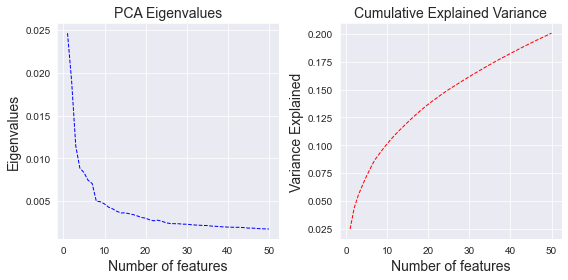

In [92]:
# Plot explained_variance_ and explained variance ratio - CountVectorizer Features (title)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plot above shows that the top 50 PC's account for only about 20% of the variability in the data.

In [93]:
%%time
# Fit an instance of TruncatedSVD to X_train_counttext

PC=TSVD.fit_transform(X_train_counttext)
X_train_counttext_PCA=pd.DataFrame(data=PC,columns=['pc51','pc52','pc53','pc54','pc55','pc56','pc57','pc58','pc59','pc60',
                                                   'pc61','pc62','pc63','pc64','pc65','pc66','pc67','pc68','pc69',
                                                     'pc70','pc71','pc72','pc73','pc74','pc75','pc76','pc77','pc78','pc79','pc80',
                                                   'pc81','pc82','pc83','pc84','pc85','pc86','pc87','pc88','pc89',
                                                     'pc90','pc91','pc92','pc93','pc94','pc95','pc96','pc97','pc98','pc99',
                                                     'pc100'])

CPU times: user 10 s, sys: 3.01 s, total: 13.1 s
Wall time: 2.32 s


In [94]:
# Apply to validation and test data
PC1=TSVD.transform(X_test_counttext)
X_test_counttext_PCA=pd.DataFrame(data=PC1,columns=['pc51','pc52','pc53','pc54','pc55','pc56','pc57','pc58','pc59','pc60',
                                                   'pc61','pc62','pc63','pc64','pc65','pc66','pc67','pc68','pc69',
                                                     'pc70','pc71','pc72','pc73','pc74','pc75','pc76','pc77','pc78','pc79','pc80',
                                                   'pc81','pc82','pc83','pc84','pc85','pc86','pc87','pc88','pc89',
                                                     'pc90','pc91','pc92','pc93','pc94','pc95','pc96','pc97','pc98','pc99',
                                                     'pc100'])

PC2=TSVD.transform(X_val_counttext)
X_val_counttext_PCA=pd.DataFrame(data=PC2,columns=['pc51','pc52','pc53','pc54','pc55','pc56','pc57','pc58','pc59','pc60',
                                                   'pc61','pc62','pc63','pc64','pc65','pc66','pc67','pc68','pc69',
                                                     'pc70','pc71','pc72','pc73','pc74','pc75','pc76','pc77','pc78','pc79','pc80',
                                                   'pc81','pc82','pc83','pc84','pc85','pc86','pc87','pc88','pc89',
                                                     'pc90','pc91','pc92','pc93','pc94','pc95','pc96','pc97','pc98','pc99',
                                                     'pc100'])

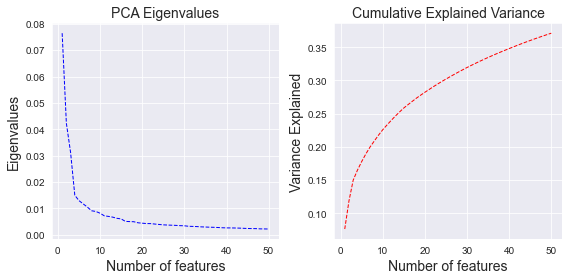

In [95]:
# Plot explained_variance_ and cumulative explained variance - CountVectorizer Features (Text)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first PC of the 'count vectoriser' dataset accounts for ~ 8% of the variability in the data, and the top 50 Principal Components account for ~ 37% of the variance in the data.

In [96]:
%%time
# Fit an instance of TruncatedSVD to X_train_tfidftitle

PC=TSVD.fit_transform(X_train_tfidftitle)
X_train_tfidftitle_PCA=pd.DataFrame(data=PC,columns=['pc101','pc102','pc103','pc104','pc105','pc106','pc107','pc108','pc109','pc110',
                                                   'pc111','pc112','pc113','pc114','pc115','pc116','pc117','pc118','pc119',
                                                     'pc120','pc121','pc122','pc123','pc124','pc125','pc126','pc127','pc128','pc129','pc130',
                                                   'pc131','pc132','pc133','pc134','pc135','pc136','pc137','pc138','pc139',
                                                     'pc140','pc141','pc142','pc143','pc144','pc145','pc146','pc147','pc148','pc149',
                                                     'pc150'])

CPU times: user 957 ms, sys: 298 ms, total: 1.25 s
Wall time: 198 ms


In [97]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidftitle)
X_test_tfidftitle_PCA=pd.DataFrame(data=PC1,columns=['pc101','pc102','pc103','pc104','pc105','pc106','pc107','pc108','pc109','pc110',
                                                   'pc111','pc112','pc113','pc114','pc115','pc116','pc117','pc118','pc119',
                                                     'pc120','pc121','pc122','pc123','pc124','pc125','pc126','pc127','pc128','pc129','pc130',
                                                   'pc131','pc132','pc133','pc134','pc135','pc136','pc137','pc138','pc139',
                                                     'pc140','pc141','pc142','pc143','pc144','pc145','pc146','pc147','pc148','pc149',
                                                     'pc150'])

PC2=TSVD.transform(X_val_tfidftitle)
X_val_tfidftitle_PCA=pd.DataFrame(data=PC2,columns=['pc101','pc102','pc103','pc104','pc105','pc106','pc107','pc108','pc109','pc110',
                                                   'pc111','pc112','pc113','pc114','pc115','pc116','pc117','pc118','pc119',
                                                     'pc120','pc121','pc122','pc123','pc124','pc125','pc126','pc127','pc128','pc129','pc130',
                                                   'pc131','pc132','pc133','pc134','pc135','pc136','pc137','pc138','pc139',
                                                     'pc140','pc141','pc142','pc143','pc144','pc145','pc146','pc147','pc148','pc149',
                                                     'pc150'])

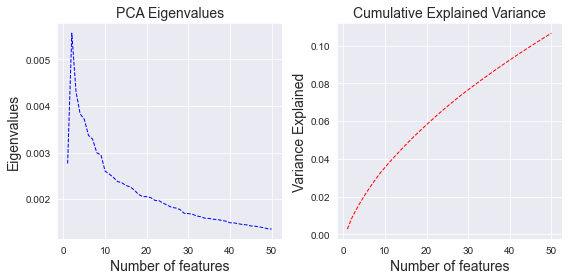

In [98]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF Features (Title)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 20 PCs of the 'TF-IDF vectoriser' title dataset account for only ~ 12% of the variability in the data.

In [99]:
%%time
# Fit an instance of TruncatedSVD to X_train_tfidftext

PC=TSVD.fit_transform(X_train_tfidftext)
X_train_tfidftext_PCA=pd.DataFrame(data=PC,columns=['pc151','pc152','pc153','pc154','pc155','pc156','pc157','pc158','pc159','pc160',
                                                   'pc161','pc162','pc163','pc164','pc165','pc166','pc167','pc168','pc169',
                                                     'pc170','pc171','pc172','pc173','pc174','pc175','pc176','pc177','pc178','pc179','pc180',
                                                   'pc181','pc182','pc183','pc184','pc185','pc186','pc187','pc188','pc189',
                                                     'pc190','pc191','pc192','pc193','pc194','pc195','pc196','pc197','pc198','pc199',
                                                     'pc200'])

CPU times: user 5.15 s, sys: 1.24 s, total: 6.39 s
Wall time: 947 ms


In [100]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidftext)
X_test_tfidftext_PCA=pd.DataFrame(data=PC1,columns=['pc151','pc152','pc153','pc154','pc155','pc156','pc157','pc158','pc159','pc160',
                                                   'pc161','pc162','pc163','pc164','pc165','pc166','pc167','pc168','pc169',
                                                     'pc170','pc171','pc172','pc173','pc174','pc175','pc176','pc177','pc178','pc179','pc180',
                                                   'pc181','pc182','pc183','pc184','pc185','pc186','pc187','pc188','pc189',
                                                     'pc190','pc191','pc192','pc193','pc194','pc195','pc196','pc197','pc198','pc199',
                                                     'pc200'])

PC2=TSVD.transform(X_val_tfidftext)
X_val_tfidftext_PCA=pd.DataFrame(data=PC2,columns=['pc151','pc152','pc153','pc154','pc155','pc156','pc157','pc158','pc159','pc160',
                                                   'pc161','pc162','pc163','pc164','pc165','pc166','pc167','pc168','pc169',
                                                     'pc170','pc171','pc172','pc173','pc174','pc175','pc176','pc177','pc178','pc179','pc180',
                                                   'pc181','pc182','pc183','pc184','pc185','pc186','pc187','pc188','pc189',
                                                     'pc190','pc191','pc192','pc193','pc194','pc195','pc196','pc197','pc198','pc199',
                                                     'pc200'])

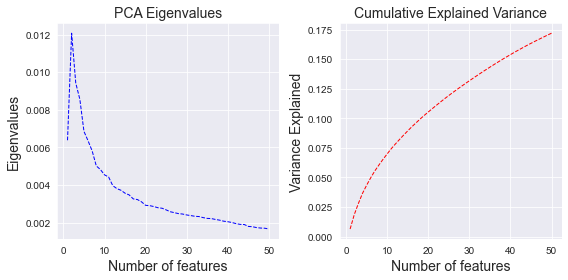

In [101]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF Features (Text)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 50 PCs of the 'TF-IDF vectoriser' TEXT dataset account for 17.5% of the variability in the data.

In [102]:
%%time
# Fit an instance of TruncatedSVD to X_train_tfidf_ngramtitle

PC=TSVD.fit_transform(X_train_tfidf_ngramtitle)
X_train_tfidf_ngramtitle_PCA=pd.DataFrame(data=PC,columns=['pc201','pc202','pc203','pc204','pc205','pc206','pc207','pc208','pc209','pc210',
                                                   'pc211','pc212','pc213','pc214','pc215','pc216','pc217','pc218','pc219',
                                                     'pc220','pc221','pc222','pc223','pc224','pc225','pc226','pc227','pc228','pc229','pc230',
                                                   'pc231','pc232','pc233','pc234','pc235','pc236','pc237','pc238','pc239',
                                                     'pc240','pc241','pc242','pc243','pc244','pc245','pc246','pc247','pc248','pc249',
                                                     'pc250'])

CPU times: user 901 ms, sys: 311 ms, total: 1.21 s
Wall time: 199 ms


In [103]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidf_ngramtitle)
X_test_tfidf_ngramtitle_PCA=pd.DataFrame(data=PC1,columns=['pc201','pc202','pc203','pc204','pc205','pc206','pc207','pc208','pc209','pc210',
                                                   'pc211','pc212','pc213','pc214','pc215','pc216','pc217','pc218','pc219',
                                                     'pc220','pc221','pc222','pc223','pc224','pc225','pc226','pc227','pc228','pc229','pc230',
                                                   'pc231','pc232','pc233','pc234','pc235','pc236','pc237','pc238','pc239',
                                                     'pc240','pc241','pc242','pc243','pc244','pc245','pc246','pc247','pc248','pc249',
                                                     'pc250'])

PC2=TSVD.transform(X_val_tfidf_ngramtitle)
X_val_tfidf_ngramtitle_PCA=pd.DataFrame(data=PC2,columns=['pc201','pc202','pc203','pc204','pc205','pc206','pc207','pc208','pc209','pc210',
                                                   'pc211','pc212','pc213','pc214','pc215','pc216','pc217','pc218','pc219',
                                                     'pc220','pc221','pc222','pc223','pc224','pc225','pc226','pc227','pc228','pc229','pc230',
                                                   'pc231','pc232','pc233','pc234','pc235','pc236','pc237','pc238','pc239',
                                                     'pc240','pc241','pc242','pc243','pc244','pc245','pc246','pc247','pc248','pc249',
                                                     'pc250'])

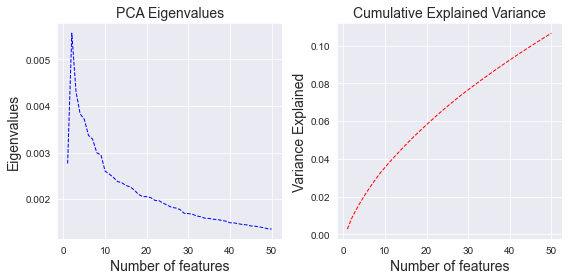

In [104]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF N-GRAM Features (Title)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 50 PC's of the 'TF-IDF vectoriser ngrams' TITLE dataset accounts for only ~12% of the variability in the data.

In [105]:
# Fit an instance of TruncatedSVD to X_train_tfidf_ngramtext

PC=TSVD.fit_transform(X_train_tfidf_ngramtext)
X_train_tfidf_ngramtext_PCA=pd.DataFrame(data=PC,columns=['pc251','pc252','pc253','pc254','pc255','pc256','pc257','pc258','pc259','pc260',
                                                   'pc261','pc262','pc263','pc264','pc265','pc266','pc267','pc268','pc269',
                                                     'pc270','pc271','pc272','pc273','pc274','pc275','pc276','pc277','pc278','pc279','pc280',
                                                   'pc281','pc282','pc283','pc284','pc285','pc286','pc287','pc288','pc289',
                                                     'pc290','pc291','pc292','pc293','pc294','pc295','pc296','pc297','pc298','pc299',
                                                     'pc300'])

In [106]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidf_ngramtext)
X_test_tfidf_ngramtext_PCA=pd.DataFrame(data=PC1,columns=['pc251','pc252','pc253','pc254','pc255','pc256','pc257','pc258','pc259','pc260',
                                                   'pc261','pc262','pc263','pc264','pc265','pc266','pc267','pc268','pc269',
                                                     'pc270','pc271','pc272','pc273','pc274','pc275','pc276','pc277','pc278','pc279','pc280',
                                                   'pc281','pc282','pc283','pc284','pc285','pc286','pc287','pc288','pc289',
                                                     'pc290','pc291','pc292','pc293','pc294','pc295','pc296','pc297','pc298','pc299',
                                                     'pc300'])

PC2=TSVD.transform(X_val_tfidf_ngramtext)
X_val_tfidf_ngramtext_PCA=pd.DataFrame(data=PC2,columns=['pc251','pc252','pc253','pc254','pc255','pc256','pc257','pc258','pc259','pc260',
                                                   'pc261','pc262','pc263','pc264','pc265','pc266','pc267','pc268','pc269',
                                                     'pc270','pc271','pc272','pc273','pc274','pc275','pc276','pc277','pc278','pc279','pc280',
                                                   'pc281','pc282','pc283','pc284','pc285','pc286','pc287','pc288','pc289',
                                                     'pc290','pc291','pc292','pc293','pc294','pc295','pc296','pc297','pc298','pc299',
                                                     'pc300'])

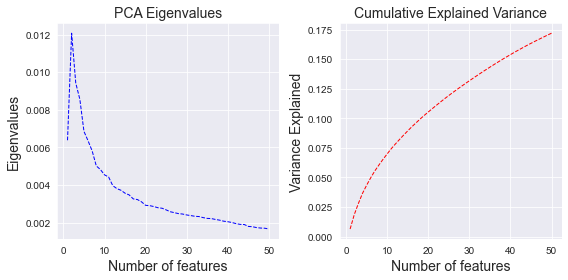

In [107]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF N-GRAM Features (Text)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 50 PC's of the 'TF-IDF vectoriser ngrams' TEXT dataset accounts for 17.5% of the variability in the data.

In [108]:
# Fit an instance of TruncatedSVD to X_train_tfidf_ngram_charstitle

PC=TSVD.fit_transform(X_train_tfidf_ngram_charstitle)
X_train_tfidf_ngram_charstitle_PCA=pd.DataFrame(data=PC,columns=['pc301','pc302','pc303','pc304','pc305','pc306','pc307','pc308','pc309','pc310',
                                                   'pc311','pc312','pc313','pc314','pc315','pc316','pc317','pc318','pc319',
                                                     'pc320','pc321','pc322','pc323','pc324','pc325','pc326','pc327','pc328','pc329','pc330',
                                                   'pc331','pc332','pc333','pc334','pc335','pc336','pc337','pc338','pc339',
                                                     'pc340','pc341','pc342','pc343','pc344','pc345','pc346','pc347','pc348','pc349',
                                                     'pc350'])

In [109]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidf_ngram_charstitle)
X_test_tfidf_ngram_charstitle_PCA=pd.DataFrame(data=PC1,columns=['pc301','pc302','pc303','pc304','pc305','pc306','pc307','pc308','pc309','pc310',
                                                   'pc311','pc312','pc313','pc314','pc315','pc316','pc317','pc318','pc319',
                                                     'pc320','pc321','pc322','pc323','pc324','pc325','pc326','pc327','pc328','pc329','pc330',
                                                   'pc331','pc332','pc333','pc334','pc335','pc336','pc337','pc338','pc339',
                                                     'pc340','pc341','pc342','pc343','pc344','pc345','pc346','pc347','pc348','pc349',
                                                     'pc350'])

PC2=TSVD.transform(X_val_tfidf_ngram_charstitle)
X_val_tfidf_ngram_charstitle_PCA=pd.DataFrame(data=PC2,columns=['pc301','pc302','pc303','pc304','pc305','pc306','pc307','pc308','pc309','pc310',
                                                   'pc311','pc312','pc313','pc314','pc315','pc316','pc317','pc318','pc319',
                                                     'pc320','pc321','pc322','pc323','pc324','pc325','pc326','pc327','pc328','pc329','pc330',
                                                   'pc331','pc332','pc333','pc334','pc335','pc336','pc337','pc338','pc339',
                                                     'pc340','pc341','pc342','pc343','pc344','pc345','pc346','pc347','pc348','pc349',
                                                     'pc350'])

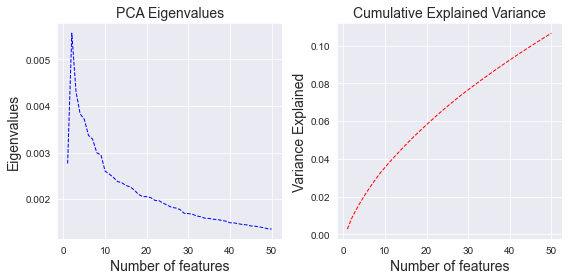

In [110]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF N-GRAM CHAR Features (Title)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 50 PC's of the 'TF-IDF vectoriser ngrams character' TITLE dataset accounts for ~12% of the variability in the data.

In [111]:
# Fit an instance of TruncatedSVD to X_train_tfidf_ngram_charstext

PC=TSVD.fit_transform(X_train_tfidf_ngram_charstext)
X_train_tfidf_ngram_charstext_PCA=pd.DataFrame(data=PC,columns=['pc351','pc352','pc353','pc354','pc355','pc356','pc357','pc358','pc359','pc360',
                                                   'pc361','pc362','pc363','pc364','pc365','pc366','pc367','pc368','pc369',
                                                     'pc370','pc371','pc372','pc373','pc374','pc375','pc376','pc377','pc378','pc379','pc380',
                                                   'pc381','pc382','pc383','pc384','pc385','pc386','pc387','pc388','pc389',
                                                     'pc390','pc391','pc392','pc393','pc394','pc395','pc396','pc397','pc398','pc399',
                                                     'pc400'])

In [112]:
# Apply to test data
PC1=TSVD.transform(X_test_tfidf_ngram_charstext)
X_test_tfidf_ngram_charstext_PCA=pd.DataFrame(data=PC1,columns=['pc351','pc352','pc353','pc354','pc355','pc356','pc357','pc358','pc359','pc360',
                                                   'pc361','pc362','pc363','pc364','pc365','pc366','pc367','pc368','pc369',
                                                     'pc370','pc371','pc372','pc373','pc374','pc375','pc376','pc377','pc378','pc379','pc380',
                                                   'pc381','pc382','pc383','pc384','pc385','pc386','pc387','pc388','pc389',
                                                     'pc390','pc391','pc392','pc393','pc394','pc395','pc396','pc397','pc398','pc399',
                                                     'pc400'])

PC2=TSVD.transform(X_val_tfidf_ngram_charstext)
X_val_tfidf_ngram_charstext_PCA=pd.DataFrame(data=PC2,columns=['pc351','pc352','pc353','pc354','pc355','pc356','pc357','pc358','pc359','pc360',
                                                   'pc361','pc362','pc363','pc364','pc365','pc366','pc367','pc368','pc369',
                                                     'pc370','pc371','pc372','pc373','pc374','pc375','pc376','pc377','pc378','pc379','pc380',
                                                   'pc381','pc382','pc383','pc384','pc385','pc386','pc387','pc388','pc389',
                                                     'pc390','pc391','pc392','pc393','pc394','pc395','pc396','pc397','pc398','pc399',
                                                     'pc400'])

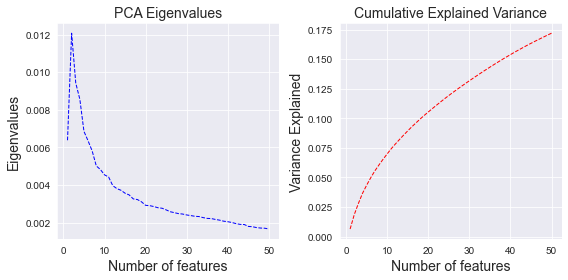

In [113]:
# Plot explained_variance_ and cumulative explained variance - TF-IDF N-GRAM CHARS Features (Text)
PC_values = np.arange(1,51,1)
expvar = TSVD.explained_variance_ratio_
cumexpvar = TSVD.explained_variance_ratio_.cumsum()
sns.set_style(style='darkgrid')
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(8,4))
ax1.plot(PC_values, expvar, '--', linewidth=1, color='blue')
ax2.plot(PC_values, cumexpvar, '--', linewidth=1, color='red')

ax1.set_title('PCA Eigenvalues',fontsize=14)
ax1.set_xlabel('Number of features', fontsize=14)
ax1.set_ylabel('Eigenvalues', fontsize=14)
ax2.set_title('Cumulative Explained Variance',fontsize=14)
ax2.set_xlabel('Number of features', fontsize=14)
ax2.set_ylabel('Variance Explained', fontsize=14)

plt.tight_layout()
plt.show()

##### The plots above indicate that the first 50 PC's of the 'TF-IDF vectoriser ngrams character' TEXT dataset accounts for ~17.5% of the variability in the data.

### Concatenating multiple datasets to generate a single dataframe with maximal numbers of features for the predictive modelling

#### The following dataframes need to be concatenated (and the X_train versions in their own dataframe)
 
 - X_train
 - X_train_topicstitle_DF
 - X_train_counttitle_PCA
 - X_train_counttext_PCA
 - X_train_tfidftitle_PCA
 - X_train_tfidftext_PCA
 - X_train_tfidf_ngramtitle_PCA
 - X_train_tfidf_ngramtext_PCA
 - X_train_tfidf_ngram_charstitle_PCA
 - X_train_tfidf_ngram_charstext_PCA

In [114]:
# Check shapes
print(X_train.shape)
print(X_train_topicstitle_DF.shape)
print(X_train_counttitle_PCA.shape)
print(X_train_counttext_PCA.shape)
print(X_train_tfidftitle_PCA.shape)
print(X_train_tfidftext_PCA.shape)
print(X_train_tfidf_ngramtitle_PCA.shape)
print(X_train_tfidf_ngramtext_PCA.shape)
print(X_train_tfidf_ngram_charstitle_PCA.shape)
print(X_train_tfidf_ngram_charstext_PCA.shape)
print(y_train.shape)

(26932, 26)
(26932, 40)
(26932, 50)
(26932, 50)
(26932, 50)
(26932, 50)
(26932, 50)
(26932, 50)
(26932, 50)
(26932, 50)
(26932,)


In [115]:
# Check shapes
print(X_val.shape)
print(X_val_topicstitle_DF.shape)
print(X_val_counttitle_PCA.shape)
print(X_val_counttext_PCA.shape)
print(X_val_tfidftitle_PCA.shape)
print(X_val_tfidftext_PCA.shape)
print(X_val_tfidf_ngramtitle_PCA.shape)
print(X_val_tfidf_ngramtext_PCA.shape)
print(X_val_tfidf_ngram_charstitle_PCA.shape)
print(X_val_tfidf_ngram_charstext_PCA.shape)
print(y_val.shape)

(8978, 26)
(8978, 40)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978,)


In [116]:
# Check shapes
print(X_test.shape)
print(X_test_topicstitle_DF.shape)
print(X_test_counttitle_PCA.shape)
print(X_test_counttext_PCA.shape)
print(X_test_tfidftitle_PCA.shape)
print(X_test_tfidftext_PCA.shape)
print(X_test_tfidf_ngramtitle_PCA.shape)
print(X_test_tfidf_ngramtext_PCA.shape)
print(X_test_tfidf_ngram_charstitle_PCA.shape)
print(X_test_tfidf_ngram_charstext_PCA.shape)
print(y_test.shape)

(8978, 26)
(8978, 40)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978, 50)
(8978,)


In [124]:
# Concatenate the dataframes
X_train_combined = pd.concat([X_train_topicstitle_DF, X_train_counttitle_PCA, X_train_counttext_PCA, X_train_tfidftitle_PCA, X_train_tfidftext_PCA, 
           X_train_tfidf_ngramtitle_PCA, X_train_tfidf_ngramtext_PCA, X_train_tfidf_ngram_charstitle_PCA, 
          X_train_tfidf_ngram_charstext_PCA], axis=1)

X_val_combined = pd.concat([X_val_topicstitle_DF, X_val_counttitle_PCA, X_val_counttext_PCA, X_val_tfidftitle_PCA, X_val_tfidftext_PCA, 
           X_val_tfidf_ngramtitle_PCA, X_val_tfidf_ngramtext_PCA, X_val_tfidf_ngram_charstitle_PCA, 
          X_val_tfidf_ngram_charstext_PCA], axis=1)

X_test_combined = pd.concat([X_test_topicstitle_DF, X_test_counttitle_PCA, X_test_counttext_PCA, X_test_tfidftitle_PCA, X_test_tfidftext_PCA, 
           X_test_tfidf_ngramtitle_PCA, X_test_tfidf_ngramtext_PCA, X_test_tfidf_ngram_charstitle_PCA, 
          X_test_tfidf_ngram_charstext_PCA], axis=1)

In [123]:
# Reset indices
X_train.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')
X_val.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')
X_test.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')

In [126]:
# Reset indices
X_train_combined.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')
X_val_combined.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')
X_test_combined.reset_index(level=None, drop=False, inplace=True, col_level=0, col_fill='')

In [128]:
# Concatenate the dataframes
X_train_combined = pd.concat([X_train, X_train_combined], axis=1)
X_val_combined = pd.concat([X_val, X_val_combined], axis=1)
X_test_combined = pd.concat([X_test, X_test_combined], axis=1)

In [129]:
# Check shapes
  # Sometimes there is a problem with concatenation, with the number of rows increasing, esp. for the X_test dataset
print(X_train_combined.shape)
print(X_val_combined.shape)
print(X_test_combined.shape)

(26932, 468)
(8978, 468)
(8978, 468)


In [132]:
X_train_combined.head(3)

,index,title,text,date,target,title_lema,text_lema,word_count,character_count,mean_word_length,...,pc391,pc392,pc393,pc394,pc395,pc396,pc397,pc398,pc399,pc400
0,29742,Trump accuses civil rights leader Lewis of lyi...,WASHINGTON (Reuters) - U.S. President-elect Do...,2017-01-17,1,trump accuse civil right leader lewis lie inau...,WASHINGTON Reuters US President elect Dona...,459,2840,6.173913,...,0.011522,-0.049608,-0.036614,0.028543,0.036098,-0.027914,0.017060,-0.001832,-0.002843,-0.002567
1,6003,The Obamas Gave A Heartbreaking Tribute To Mu...,The last couple of years have been rampant wit...,2016-06-05,0,obamas give heartbreaking tribute muhammad al...,couple year rampant like premature death able...,577,3125,5.406574,...,-0.021305,-0.025634,-0.018579,0.016856,0.007517,-0.023940,-0.000541,-0.014882,-0.017444,-0.007954
2,7974,Trump BASHES Obama With Hostile Fiction For N...,There are a lot of things citizens of the Unit...,2016-02-20,0,trump bash obama hostile fiction attend scali...,lot thing citizen United States look Commander...,409,2248,5.482927,...,0.006483,0.017475,0.028391,0.029549,-0.026283,-0.003769,-0.030916,-0.033769,-0.004615,-0.012071


In [133]:
# Drop the unnecessary columns from X_train, X_val and X_test
X_train_combined.drop(axis=1, columns=['index','title','text','date','target','title_lema','text_lema'], inplace=True)
X_val_combined.drop(axis=1, columns=['index','title','text','date','target','title_lema','text_lema'], inplace=True)
X_test_combined.drop(axis=1, columns=['index','title','text','date','target','title_lema','text_lema'], inplace=True)

In [135]:
# Check shapes
  # Looks good!
print("X_train_combined shape: ", X_train_combined.shape)
print("X_val_combined shape: ", X_val_combined.shape)
print("X_test_combined shape: ", X_test_combined.shape)

X_train_combined shape:  (26932, 460)
X_val_combined shape:  (8978, 460)
X_test_combined shape:  (8978, 460)


In [136]:
X_train_combined.head(3)

,word_count,character_count,mean_word_length,punctuation_count,title_word_count,uppercase_word_count,adj_count_title,adv_count_title,noun_count_title,num_count_title,...,pc391,pc392,pc393,pc394,pc395,pc396,pc397,pc398,pc399,pc400
0,459,2840,6.173913,459,88,8,1.0,0.0,3.0,0.0,...,0.011522,-0.049608,-0.036614,0.028543,0.036098,-0.027914,0.017060,-0.001832,-0.002843,-0.002567
1,577,3125,5.406574,577,104,9,0.0,0.0,2.0,0.0,...,-0.021305,-0.025634,-0.018579,0.016856,0.007517,-0.023940,-0.000541,-0.014882,-0.017444,-0.007954
2,409,2248,5.482927,409,61,6,1.0,0.0,0.0,0.0,...,0.006483,0.017475,0.028391,0.029549,-0.026283,-0.003769,-0.030916,-0.033769,-0.004615,-0.012071


In [183]:
# Export the dataframes as csv files

X_train_combined.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/X_train_combined.csv')
X_val_combined.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/X_val_combined.csv')
X_test_combined.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/X_test_combined.csv')
y_train.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/y_train.csv')
y_val.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/y_val.csv')
y_test.to_csv(r'/Users/gaylecferguson/Data/MiniProject3/y_test.csv')

## MODELLING

In [138]:
# Reimport the data from csv files
X_train_combined = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/X_train_combined.csv', header=0, sep=',')
X_val_combined = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/X_val_combined.csv', header=0, sep=',')
X_test_combined = pd.read_csv (r'/Users/gaylecferguson/Data/MiniProject3/X_test_combined.csv', header=0, sep=',')
X_train_combined.head(3)

,Unnamed: 0,word_count,character_count,mean_word_length,punctuation_count,title_word_count,uppercase_word_count,adj_count_title,adv_count_title,noun_count_title,...,pc391,pc392,pc393,pc394,pc395,pc396,pc397,pc398,pc399,pc400
0,0,459,2840,6.173913,459,88,8,1.0,0.0,3.0,...,0.011522,-0.049608,-0.036614,0.028543,0.036098,-0.027914,0.017060,-0.001832,-0.002843,-0.002567
1,1,577,3125,5.406574,577,104,9,0.0,0.0,2.0,...,-0.021305,-0.025634,-0.018579,0.016856,0.007517,-0.023940,-0.000541,-0.014882,-0.017444,-0.007954
2,2,409,2248,5.482927,409,61,6,1.0,0.0,0.0,...,0.006483,0.017475,0.028391,0.029549,-0.026283,-0.003769,-0.030916,-0.033769,-0.004615,-0.012071


In [139]:
# Delete the 'Unnamed:0' column
X_train_combined = X_train_combined.drop(axis=1, columns=['Unnamed: 0'], inplace=False)
X_val_combined = X_val_combined.drop(axis=1, columns=['Unnamed: 0'], inplace=False)
X_test_combined = X_test_combined.drop(axis=1, columns=['Unnamed: 0'], inplace=False)

In [140]:
# Check shape

print("X_train_combined shape: ", X_train_combined.shape)
print("y_train shape: ", y_train.shape)
print("X_val_combined shape: ", X_val_combined.shape)
print("y_val shape: ", y_val.shape)
print("X_test_combined shape: ", X_test_combined.shape)
print("y_test shape: ", y_test.shape)

X_train_combined shape:  (26932, 460)
y_train shape:  (26932,)
X_val_combined shape:  (8978, 460)
y_val shape:  (8978,)
X_test_combined shape:  (8978, 460)
y_test shape:  (8978,)


In [141]:
## helper function

def train_model(classifier, feature_vector_train, label, feature_vector_valid):
    # fit the training dataset on the classifier
    classifier.fit(feature_vector_train, label)

    # predict the labels on validation dataset
    predictions = classifier.predict(feature_vector_valid)

    return accuracy_score(predictions, y_test)

In [142]:
# Keep the results in a dataframe
results = pd.DataFrame(columns = ['Dataset 1 (X_train_combined)','Dataset 2 (X_val_combined)'])

### Naive Bayes Classifier

Each model was implemented using the default features in the first instance.

In [151]:
%%time
# Naive Bayes

clf1 = GaussianNB()

scores1 = cross_val_score(clf1, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (Gaussian NB, train): %.2f [%s]' % (scores1.mean(), scores1.std()))
    
scores2 = cross_val_score(clf1, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (Gaussian NB, validation): %.2f [%s]' % (scores2.mean(), scores2.std()))

Accuracy (Gaussian NB, train): 0.91 [0.0051740302029145615]
Accuracy (Gaussian NB, validation): 0.90 [0.02117183908393272]
CPU times: user 554 ms, sys: 171 ms, total: 725 ms
Wall time: 839 ms


In [152]:
results.loc['Naïve Bayes'] = {
    'Dataset 1 (X_train_combined)': scores1.mean(), 'Dataset 2 (X_val_combined)': scores2.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881


### Logistic Regression

In [153]:
%%time
# Logistic Regression on Dataset 1

clf2 = LogisticRegression(solver = 'lbfgs', max_iter = 350, random_state=1)

scores3 = cross_val_score(clf2, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (Logistic Regression, train): %.2f [%s]' % (scores3.mean(), scores3.std()))
    
scores4 = cross_val_score(clf2, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (Logistic Regression, validation): %.2f [%s]' % (scores4.mean(), scores4.std()))

Accuracy (Logistic Regression, train): 0.98 [0.0019582166882677584]
Accuracy (Logistic Regression, validation): 0.98 [0.004465943548835541]
CPU times: user 1min 22s, sys: 11 s, total: 1min 33s
Wall time: 14.1 s


In [154]:
results.loc['Logistic Regression'] = {
    'Dataset 1 (X_train_combined)': scores3.mean(), 'Dataset 2 (X_val_combined)': scores4.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839


### Support Vector Machine (SVC)

In [156]:
%%time
# Linear SVC on Dataset 1

clf3 = LinearSVC(max_iter = 10000, random_state=1)

scores5 = cross_val_score(clf3, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (LinearSVC, train): %.2f [%s]' % (scores5.mean(), scores5.std()))
    
scores6 = cross_val_score(clf3, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (LinearSVC, validation): %.2f [%s]' % (scores6.mean(), scores6.std()))

Accuracy (LinearSVC, train): 0.97 [0.01131584698072912]
Accuracy (LinearSVC, validation): 0.97 [0.007855677465450883]
CPU times: user 10min 52s, sys: 6.05 s, total: 10min 58s
Wall time: 10min 48s


In [157]:
results.loc['LinearSVC'] = {
    'Dataset 1 (X_train_combined)': scores5.mean(), 'Dataset 2 (X_val_combined)': scores6.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155


In [160]:
%%time
# SVC on Dataset 1

clf4 = SVC(kernel='linear', max_iter = 10000, random_state=1)

scores7 = cross_val_score(clf4, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (SVC, train): %.2f [%s]' % (scores7.mean(), scores7.std()))
    
scores8 = cross_val_score(clf4, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (SVC, validation): %.2f [%s]' % (scores8.mean(), scores8.std()))

Accuracy (SVC, train): 0.81 [0.06941628514223076]
Accuracy (SVC, validation): 0.78 [0.15379635644806589]
CPU times: user 11.8 s, sys: 230 ms, total: 12 s
Wall time: 12.1 s


In [161]:
results.loc['SVC'] = {
    'Dataset 1 (X_train_combined)': scores7.mean(), 'Dataset 2 (X_val_combined)': scores8.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155
SVC,0.814605,0.776331


### Random Forest

In [162]:
%%time
# Bagging (Random Forest) on Dataset 1

clf5 = RandomForestClassifier(n_estimators = 100, random_state=1)

scores9 = cross_val_score(clf5, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (Random Forest, train): %.2f [%s]' % (scores9.mean(), scores9.std()))

scores10 = cross_val_score(clf5, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (Random Forest, validation): %.2f [%s]' % (scores10.mean(), scores10.std()))

Accuracy (Random Forest, train): 0.99 [0.0011828225314468733]
Accuracy (Random Forest, validation): 0.98 [0.002353360517272068]
CPU times: user 3min 30s, sys: 1.4 s, total: 3min 32s
Wall time: 3min 32s


In [163]:
results.loc['Random Forest'] = {
    'Dataset 1 (X_train_combined)': scores9.mean(), 'Dataset 2 (X_val_combined)': scores10.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155
SVC,0.814605,0.776331
Random Forest,0.986707,0.979060


### Gradient Boosting

In [164]:
%%time
# Gradient Boosting on Dataset 1

clf6 = GradientBoostingClassifier(random_state=1)

scores11 = cross_val_score(clf6, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (Gradient Boost, train): %.2f [%s]' % (scores11.mean(), scores11.std()))
    
scores12 = cross_val_score(clf6, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (Gradient Boost, validation): %.2f [%s]' % (scores12.mean(), scores12.std()))

Accuracy (Gradient Boost, train): 0.99 [0.001682073787437161]
Accuracy (Gradient Boost, validation): 0.99 [0.004134107050112919]
CPU times: user 24min 45s, sys: 5.86 s, total: 24min 50s
Wall time: 24min 52s


In [165]:
results.loc['Gradient Boost'] = {
    'Dataset 1 (X_train_combined)': scores11.mean(), 'Dataset 2 (X_val_combined)': scores12.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155
SVC,0.814605,0.776331
Random Forest,0.986707,0.979060
Gradient Boost,0.988638,0.986967


### XGBoost

In [166]:
# XGBoost on Dataset 1

clf7 = XGBClassifier(random_state=1)

scores13 = cross_val_score(clf7, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (XGBoost, train): %.2f [%s]' % (scores13.mean(), scores13.std()))

scores14 = cross_val_score(clf7, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (XGBoost, validation): %.2f [%s]' % (scores14.mean(), scores14.std()))

[22:25:16] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:25:39] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:26:04] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:26:30] WARNING: /Users/runner/miniforge3/cond

In [167]:
results.loc['XGBoost'] = {
    'Dataset 1 (X_train_combined)': scores13.mean(), 'Dataset 2 (X_val_combined)': scores14.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155
SVC,0.814605,0.776331
Random Forest,0.986707,0.979060
Gradient Boost,0.988638,0.986967
XGBoost,0.994171,0.990309


### Stacking Model

In [168]:
np.random.seed(0)
clf1 = GaussianNB()
clf2 = LogisticRegression(solver = 'lbfgs', max_iter = 1000, random_state=1)
clf3 = LinearSVC(max_iter = 10000, random_state=1)
clf4 = SVC(kernel='linear', max_iter = 10000, random_state=1)
clf5 = RandomForestClassifier(n_estimators = 100, random_state=1)
clf6 = GradientBoostingClassifier(random_state=1)
clf7 = XGBClassifier(random_state=1)

# Meta-classifier is Logistic Regression
sclf = StackingClassifier(classifiers = [clf1, clf3, clf4], 
                          meta_classifier = clf2)

In [169]:
%%time
# Stacking Model 

label = ['Gaussian Naïve Bayes', 'Linear SVC', 'SVC', 
         'Stacking Classifier']
clf_list = [clf1, clf3, clf4, sclf]

clf_cv_mean = []
clf_cv_std = []
for clf, label in zip(clf_list, label):
        
    scores15 = cross_val_score(clf, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
    print('Accuracy (train): %.2f (+/- %.2f) [%s]' % (scores15.mean(), scores15.std(), label))
    clf_cv_mean.append(scores15.mean())
    clf_cv_std.append(scores15.std())
    
    scores16 = cross_val_score(clf, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
    print('Accuracy (test): %.2f (+/- %.2f) [%s]' % (scores16.mean(), scores16.std(), label))
    clf_cv_mean.append(scores16.mean())
    clf_cv_std.append(scores16.std())

Accuracy (train): 0.91 (+/- 0.01) [Gaussian Naïve Bayes]
Accuracy (test): 0.90 (+/- 0.02) [Gaussian Naïve Bayes]
Accuracy (train): 0.97 (+/- 0.01) [Linear SVC]
Accuracy (test): 0.97 (+/- 0.01) [Linear SVC]
Accuracy (train): 0.81 (+/- 0.07) [SVC]
Accuracy (test): 0.78 (+/- 0.15) [SVC]
Accuracy (train): 0.97 (+/- 0.01) [Stacking Classifier]
Accuracy (test): 0.97 (+/- 0.01) [Stacking Classifier]
CPU times: user 22min 40s, sys: 15 s, total: 22min 55s
Wall time: 22min 20s


In [170]:
results.loc['Stacking'] = {
    'Dataset 1 (X_train_combined)': scores15.mean(), 'Dataset 2 (X_val_combined)': scores16.mean()}
results

,Dataset 1 (X_train_combined),Dataset 2 (X_val_combined)
Naïve Bayes,0.910367,0.904881
Logistic Regression,0.979578,0.979839
LinearSVC,0.969034,0.973155
SVC,0.814605,0.776331
Random Forest,0.986707,0.979060
Gradient Boost,0.988638,0.986967
XGBoost,0.994171,0.990309
Stacking,0.970370,0.974492


## Learning Curves to check for over-fitting

In [206]:
%%time
# Plot learning curves for a selection of models on Dataset 1

from textwrap import wrap
from sklearn.model_selection import ShuffleSplit
sns.set_theme(style="white")

def plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=None,
    ylim=None,
    cv=ShuffleSplit(n_splits=50, test_size=0.2, random_state=0),
    n_jobs=None,
    train_sizes=[0.1, 0.33, 0.55, 0.78, 1.]):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(2, 3, figsize=(20, 5))

    axes[0].set_title('\n'.join(wrap(title,40)),fontsize=14)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples",fontsize=14)
    axes[0].set_ylabel("Score",fontsize=14)

    train_sizes, train_scores, test_scores, fit_times, _ = learning_curve(
        estimator,
        X,
        y,
        cv=cv,
        n_jobs=n_jobs,
        train_sizes=train_sizes,
        return_times=True,
    )
    train_scores_mean = np.nanmean(train_scores, axis=1)
    train_scores_std = np.nanstd(train_scores, axis=1)
    test_scores_mean = np.nanmean(test_scores, axis=1)
    test_scores_std = np.nanstd(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    axes[0].fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )
    axes[0].plot(
        train_sizes, train_scores_mean, "o-", color="r", label="Training score"
    )
    axes[0].plot(
        train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score"
    )
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, "o-")
    axes[1].fill_between(
        train_sizes,
        fit_times_mean - fit_times_std,
        fit_times_mean + fit_times_std,
        alpha=0.1,
    )
    axes[1].set_xlabel("Training examples", fontsize=14)
    axes[1].set_ylabel("fit_times", fontsize=14)
    axes[1].set_title("Scalability of the model", fontsize=14)

    # Plot fit_time vs score
    fit_time_argsort = fit_times_mean.argsort()
    fit_time_sorted = fit_times_mean[fit_time_argsort]
    test_scores_mean_sorted = test_scores_mean[fit_time_argsort]
    test_scores_std_sorted = test_scores_std[fit_time_argsort]
    axes[2].grid()
    axes[2].plot(fit_time_sorted, test_scores_mean_sorted, "o-")
    axes[2].fill_between(
        fit_time_sorted,
        test_scores_mean_sorted - test_scores_std_sorted,
        test_scores_mean_sorted + test_scores_std_sorted,
        alpha=0.1,
    )
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt

CPU times: user 1.12 ms, sys: 5.36 ms, total: 6.48 ms
Wall time: 18 ms


/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#l

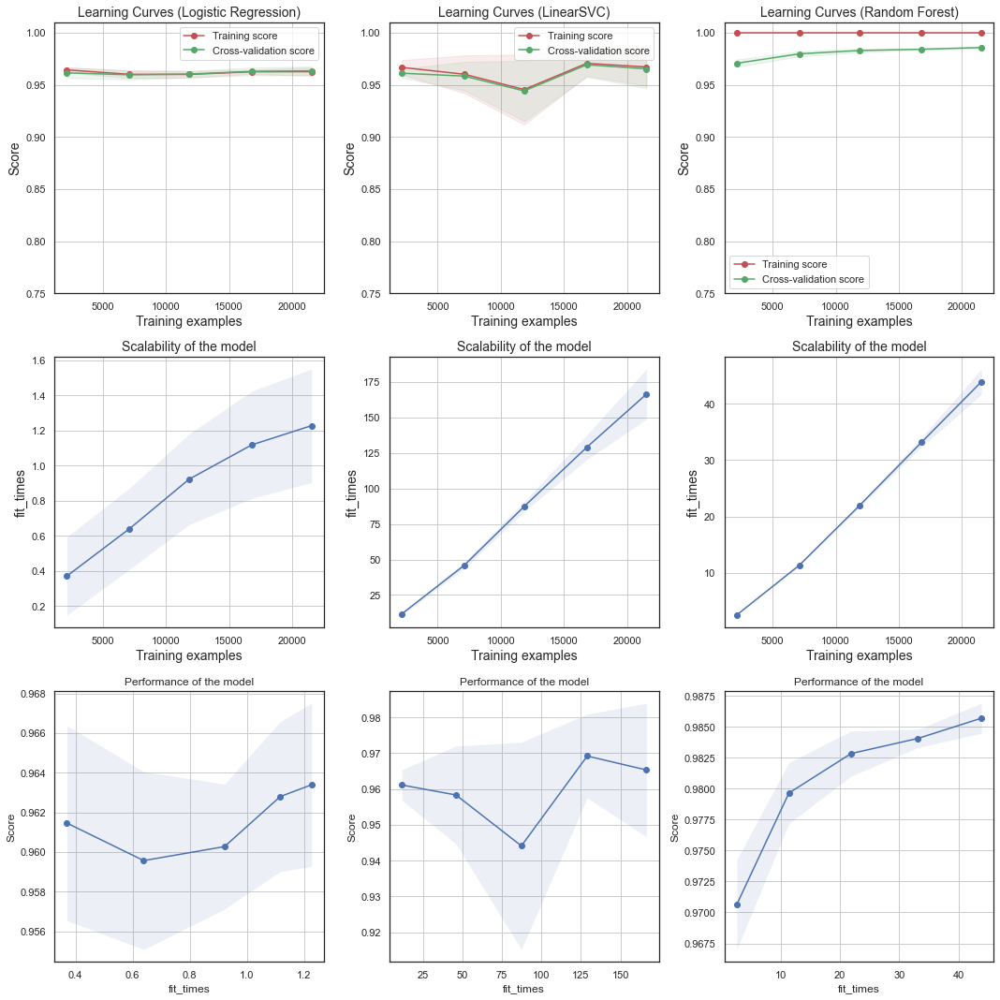

CPU times: user 1.16 s, sys: 917 ms, total: 2.08 s
Wall time: 12min 57s


In [172]:
%%time
# Plotted learning curves from the function above
  # Did not have time to run the LinearSVC model with a greater number of iterations (see warning message below). 
    
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

title = "Learning Curves (Logistic Regression)"
# Cross validation with 50 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

estimator = LogisticRegression(random_state=1)
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 0], ylim=(0.75, 1.01), cv=cv, n_jobs=4)

title = r"Learning Curves (LinearSVC)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
svc = LinearSVC(random_state=1, max_iter=10000)
estimator = svc
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 1], ylim=(0.75, 1.01), cv=cv, n_jobs=4)

title = r"Learning Curves (Random Forest)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
RF = RandomForestClassifier(n_estimators = 100, random_state=1)
estimator = RF
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 2], 
                   ylim=(0.75, 1.01), cv=cv, n_jobs=4)
fig.tight_layout()
#fig.savefig("learning_curves.jpg")
plt.show()

/Users/gaylecferguson/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/gaylecferguson/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/gaylecferguson/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/gaylecferguson/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be remove

[00:03:23] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:04:26] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:05:45] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:07:03] WARNING: /Users/runner/miniforge3/cond

/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:301: ConvergenceWarning: Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:301: ConvergenceWarning: Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of ite

[00:03:22] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:03:57] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:04:22] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:05:25] WARNING: /Users/runner/miniforge3/cond

/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:301: ConvergenceWarning: Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:301: ConvergenceWarning: Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of ite

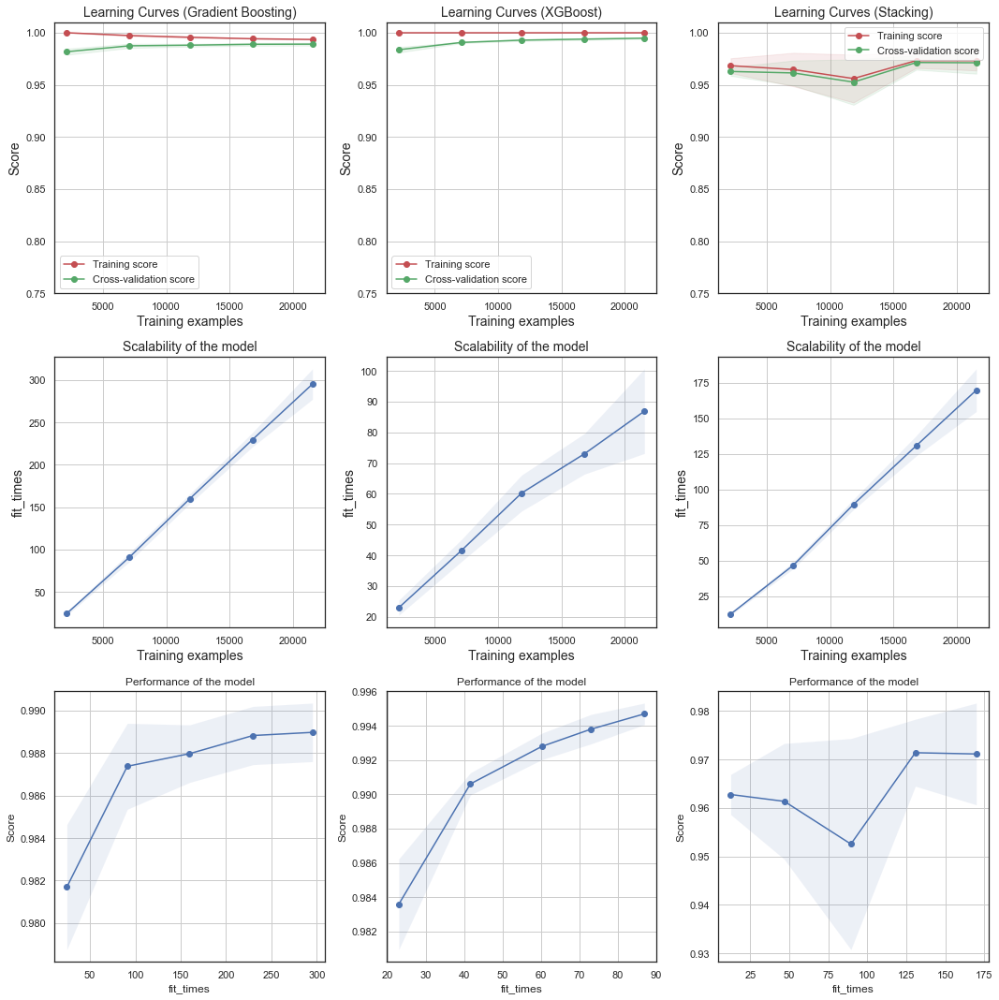

CPU times: user 1.51 s, sys: 1.32 s, total: 2.83 s
Wall time: 35min 16s
[00:03:22] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:03:42] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:05:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to res

In [173]:
%%time
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

title = "Learning Curves (Gradient Boosting)"
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = GradientBoostingClassifier(random_state=1)
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 0], ylim=(0.75, 1.01), cv=cv, n_jobs=4)

title = r"Learning Curves (XGBoost)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = XGBClassifier(random_state=1)
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 1], ylim=(0.75, 1.01), cv=cv, n_jobs=4)

title = r"Learning Curves (Stacking)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = sclf
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 2], 
                   ylim=(0.75, 1.01), cv=cv, n_jobs=4)
fig.tight_layout()
#fig.savefig("learning_curves_2.jpg")
plt.show()

## Summary Report for the Best Models

In [174]:
%%time
# helper function to show results and charts
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)

    accuracy_ = accuracy_score(actual, prediction)
    precision_ = precision_score(actual, prediction)
    recall_ = recall_score(actual, prediction)
    roc_auc_ = roc_auc_score(actual, probabilities)

    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_)
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_)
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_)
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_)
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, probabilities)
    average_precision = average_precision_score(actual, probabilities)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities)
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'Blues', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()
    
    return (accuracy_, precision_, recall_, roc_auc_)

CPU times: user 5 µs, sys: 5 µs, total: 10 µs
Wall time: 16.2 µs


In [ ]:
# Summary Report - Linear SVC
  # Can't run this for the LinearSVC model because it doesn't have the predict_proba method

#clf3.fit(X_train_combined_2, y_train) 

#actual = y_test.ravel()
#prediction = clf3.predict(X_test_combined_2) 
#probabilities = clf3.predict_proba(X_test_combined_2)[:,1]
#show_summary_report(actual, prediction, probabilities)

Accuracy : 0.9849 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9848 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9835 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9982                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


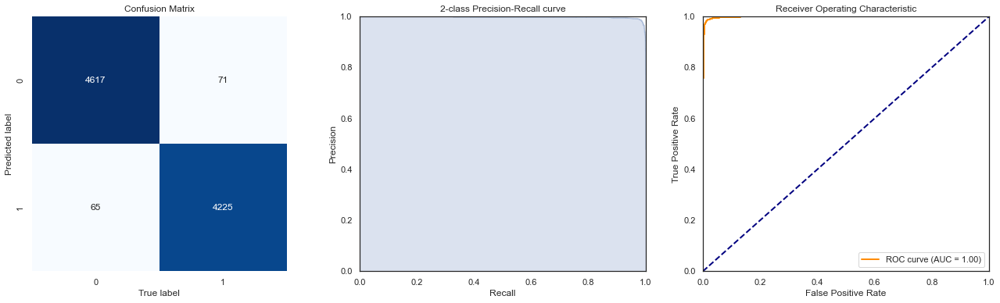

(0.9848518601024727,
 0.9848484848484849,
 0.9834729981378026,
 0.9982118311183446)

In [175]:
# Summary Report - Logistic Regression
clf2.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = clf2.predict(X_test_combined) 
probabilities = clf2.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Logistic_Regression.jpg")

Accuracy : 0.9862 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9862 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9849 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9989                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


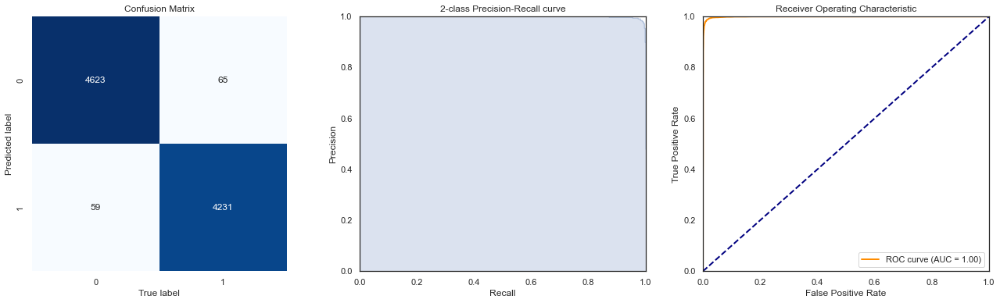

(0.9861884606816663,
 0.9862470862470862,
 0.9848696461824954,
 0.9988913869989826)

In [177]:
# Summary Report - Random Forest Classifier
clf5.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = clf5.predict(X_test_combined) 
probabilities = clf5.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#savefig("Summary_Report_Random_Forest.jpg")

Accuracy : 0.9895 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9872 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9909 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9992                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


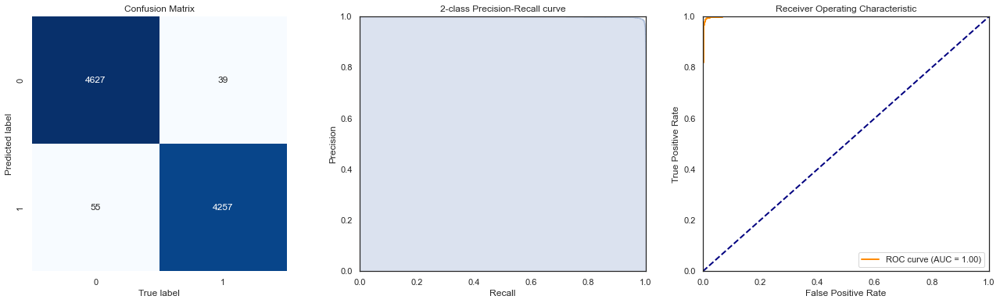

(0.9895299621296503,
 0.9872448979591837,
 0.9909217877094972,
 0.9991904592014904)

In [178]:
# Summary Report - Gradient Boosting Model
clf6.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = clf6.predict(X_test_combined) 
probabilities = clf6.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Gradient_Boosting.jpg")

[01:39:14] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy : 0.9953 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9953 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9949 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9998                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


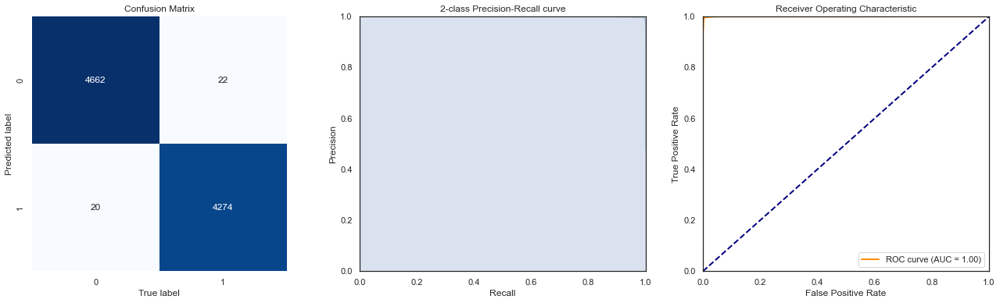

(0.9953218979728224, 0.9953423381462506, 0.99487895716946, 0.9997992927468167)

In [179]:
# Summary Report - XGBoost
clf7.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = clf7.predict(X_test_combined) 
probabilities = clf7.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Gradient_Boosting.jpg")

Accuracy : 0.9793 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9867 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9697 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9924                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


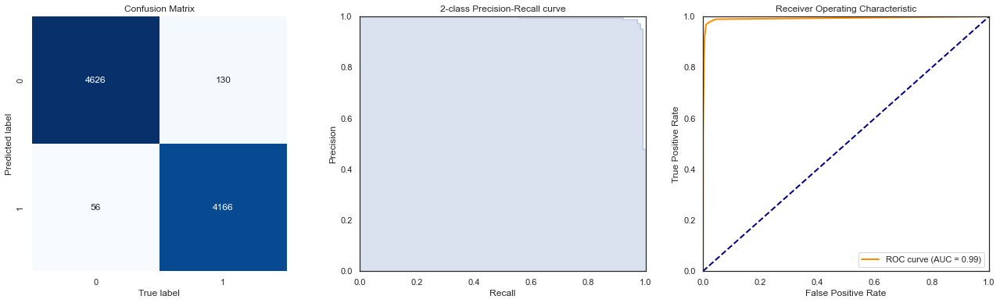

(0.9792826910224994, 0.9867361440075794, 0.9697392923649907, 0.992431367764496)

In [180]:
# Summary Report - Stacking Model
sclf.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = sclf.predict(X_test_combined) 
probabilities = sclf.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Stacking.jpg")

## Fine-tuning the Hyperparameters

In [199]:
%%time
# Refit the XGBoost model with tuned hyperparameters

xgb = XGBClassifier(random_state=1, n_estimators=400, eta=0.2, gamma=0.01, min_child_weight=1, 
                          colsample_bytree=0.5, max_depth=4, alpha=0, reg_lambda=1.2, subsample=1.0)

scores17 = cross_val_score(xgb, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (XGBoost, train): %.2f [%s]' % (scores17.mean(), scores17.std()))
    
scores18 = cross_val_score(xgb, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (XGBoost, validation): %.2f [%s]' % (scores18.mean(), scores18.std()))

[01:33:09] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:33:41] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:34:17] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:34:58] WARNING: /Users/runner/miniforge3/cond

In [213]:
# Refit the Logistic Regression model with tuned hyperparameters

logreg = LogisticRegression(C=10, penalty='l2', solver = 'lbfgs', max_iter = 10000, random_state=1)

scores19 = cross_val_score(logreg, X_train_combined, y_train, cv = 5, scoring = 'accuracy')
print('Accuracy (Logistic Regression, train): %.2f [%s]' % (scores19.mean(), scores19.std()))
    
scores20 = cross_val_score(logreg, X_val_combined, y_val, cv = 5, scoring = 'accuracy')
print('Accuracy (Logistic Regression, validation): %.2f [%s]' % (scores20.mean(), scores20.std()))

Accuracy (Logistic Regression, train): 0.99 [0.0011079873503853901]
Accuracy (Logistic Regression, validation): 0.99 [0.002506798984791448]


[01:53:58] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy : 0.9962 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9960 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9960 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9999                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


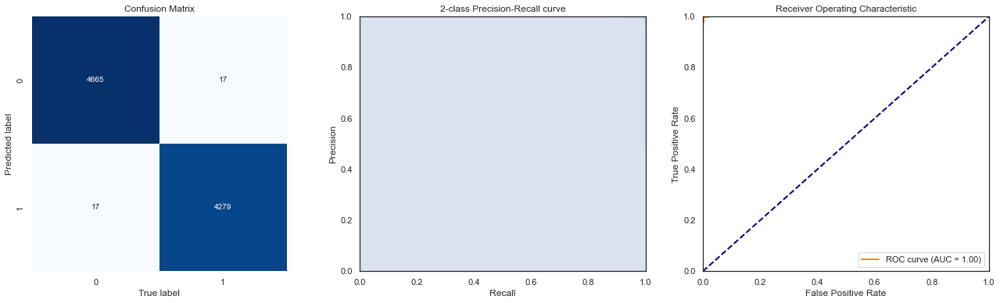

(0.9962129650256182,
 0.9960428305400373,
 0.9960428305400373,
 0.9998564175013145)

In [203]:
# Summary Report - XGBoost
xgb.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = xgb.predict(X_test_combined) 
probabilities = xgb.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Gradient_Boosting.jpg")

Accuracy : 0.9925 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9909 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9935 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9997                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


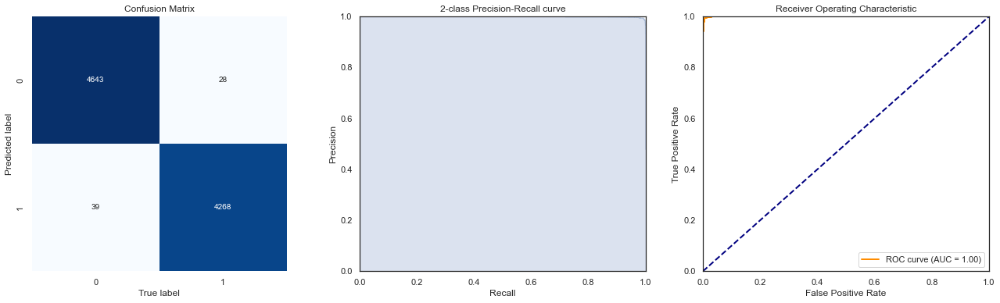

(0.9925373134328358,
 0.9909449732992802,
 0.9934823091247672,
 0.9996552627957461)

In [214]:
# Summary Report - Logistic Regression
logreg.fit(X_train_combined, y_train) 

actual = y_test.ravel()
prediction = logreg.predict(X_test_combined) 
probabilities = logreg.predict_proba(X_test_combined)[:,1]
show_summary_report(actual, prediction, probabilities)
#fig.savefig("Summary_Report_Gradient_Boosting.jpg")

/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/gaylecferguson/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#l

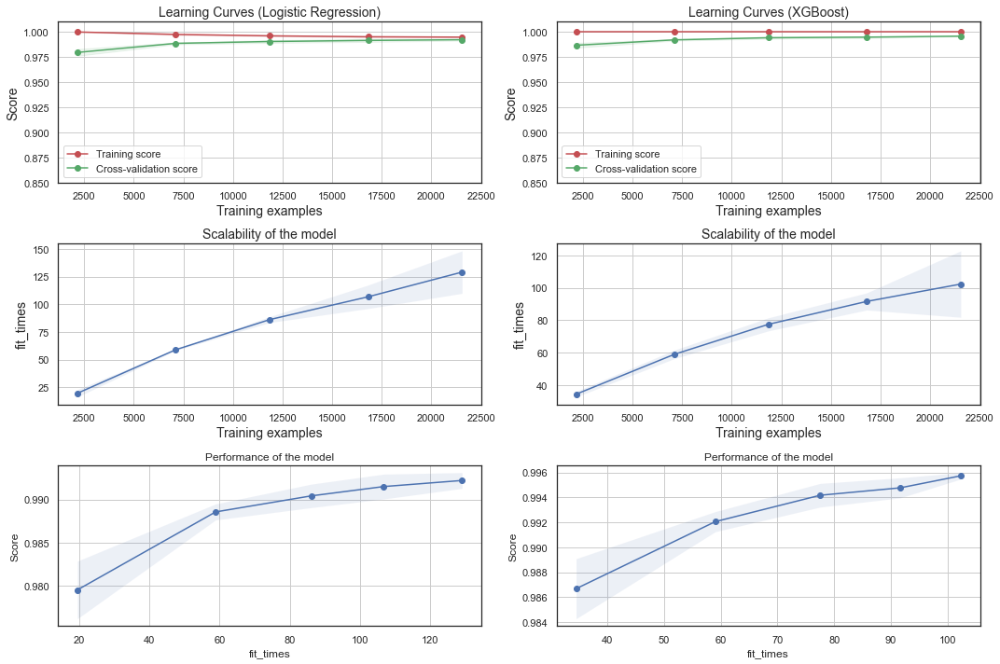

CPU times: user 1.05 s, sys: 1.02 s, total: 2.07 s
Wall time: 17min 7s
[19:44:58] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:45:30] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:47:19] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to rest

In [215]:
%%time
# Plotted learning curves for fine-tuned models - logreg and xgb
    
fig, axes = plt.subplots(3, 2, figsize=(15, 10))

title = "Learning Curves (Logistic Regression)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

estimator = logreg
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 0], ylim=(0.85, 1.01), cv=cv, n_jobs=4)

title = r"Learning Curves (XGBoost)"
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
estimator = xgb
plot_learning_curve(estimator, title, X_train_combined, y_train, axes=axes[:, 1], ylim=(0.85, 1.01), cv=cv, n_jobs=4)

fig.tight_layout()
#fig.savefig("learning_curves.jpg")
plt.show()

# CONCLUSIONS

#### NEXT STEPS

    - Topic modelling on the full text may improve model accuracy, but this is unlikely to be worth the effort.
    - Exploration of different meta-classifiers in a Stacking Model to see if accuracy can be further improved. 